<a href="https://colab.research.google.com/github/corypham/CourtCheck/blob/main/court_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Tennis Court Detection

This notebook provides a comprehensive workflow for detecting tennis court boundaries and tracking tennis balls using machine learning models. The workflow includes data preparation, model training, and post-processing to detect when a ball is in or out. This project uses Detectron2 for court detection and TrackNet for ball tracking.

## Sections
1. **Setup**: Install dependencies.
2. **Data Preparation**: Prepare and verify the dataset.
3. **Model Training**: Configure and train the model.
4. **Post Processing**: Integrating the model togetehr.


## Setup

Install necessary libraries and dependencies

In [ ]:
# Install Detectron2 and other dependencies
!pip install torch torchvision
!pip install git+https://github.com/facebookresearch/detectron2.git

# Install TensorBoard
!pip install tensorboard


  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 3108, in _dep_map
    return self.__dep_map
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 2901, in __getattr__
    raise AttributeError(attr)
AttributeError: _DistInfoDistribution__dep_map

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/base_command.py", line 169, in exc_logging_wrapper
    status = run_func(*args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/req_command.py", line 242, in wrapper
    return func(self, options, args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/install.py", line 441, in run
    conflicts = self._determine_conflicts(to_install)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/install.py", line 

In [ ]:
# Import Required Libraries
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.structures import Instances
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from detectron2.engine import DefaultPredictor
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.data.datasets import register_coco_instances
from detectron2 import model_zoo
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.evaluation import COCOEvaluator
from google.colab import drive
from google.colab.patches import cv2_imshow
from collections import defaultdict
from collections import deque
import matplotlib.pyplot as plt
import numpy as np
import logging
import os
import json
import random
import cv2
import torch
import torchvision
import time

# drive.mount('/content/drive')

import torch
print(torch.__version__)

import detectron2
print(detectron2.__version__)

2.3.1+cu121
0.6


## Data Preparation

In this section, we will prepare the data required for training the Detectron2 model. This involves defining dataset paths, verifying dataset integrity, and visualizing random samples to ensure the annotations are correct.


### Define Dataset Paths

Define the paths to your dataset and annotations. These paths are relative to your directory structure.

In [ ]:
# Configuration
session_number = 9  # Change this to the desired session number

# Number of games for training and validation
num_training_games = 6  # Specify the number of training games
num_validation_games = 3  # Specify the number of validation games

# Option to specify a custom dataset path
custom_dataset_path = None  # Set to a valid path if using a custom dataset, else None

# Determine training and validation games based on the number specified
dataset_dir = "/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset"
available_games = sorted([int(folder.split('game')[-1]) for folder in os.listdir(dataset_dir) if folder.startswith('game')])

if len(available_games) < (num_training_games + num_validation_games):
    raise ValueError("Not enough games in the directory to meet the training and validation requirements.")

train_games = available_games[:num_training_games]
val_games = available_games[num_training_games:num_training_games + num_validation_games]

# Use custom dataset path if provided
if custom_dataset_path:
    test_games = [custom_dataset_path]
else:
    test_games = val_games

print(f"Training games: {train_games}")
print(f"Validation games: {val_games}")
print(f"Testing games: {test_games}")


Training games: [1, 2, 3, 4, 5, 6]
Validation games: [7, 8, 9]
Testing games: [7, 8, 9]


In [ ]:
# Define paths (relative to your directory structure)
data_dir = "/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model"
annotations_dir = os.path.join(data_dir, "annotations/model_annotations/games/all_games")
dataset_dir = os.path.join(data_dir, "dataset")

# JSON and image directories for training
train_json_files = [os.path.join(annotations_dir, f"game{num}.json") for num in train_games]
train_image_dirs = [os.path.join(dataset_dir, f"game{num}/game{num}_images") for num in train_games]

# JSON and image directories for validation
val_json_files = [os.path.join(annotations_dir, f"game{num}.json") for num in val_games]
val_image_dirs = [os.path.join(dataset_dir, f"game{num}/game{num}_images") for num in val_games]

print("Training JSON files:", train_json_files)
print("Validation JSON files:", val_json_files)


Training JSON files: ['/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game1.json', '/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game2.json', '/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game3.json', '/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game4.json', '/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game5.json', '/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game6.json']
Validation JSON files: ['/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/g

### Verify Dataset Integrity

Ensure that each dataset has images that are all referenced in the corresponding JSON files.


In [ ]:
# Verify dataset integrity
def verify_dataset(json_files, image_dirs):
    for json_file, image_dir in zip(json_files, image_dirs):
        with open(json_file) as f:
            data = json.load(f)
        image_files = {img['file_name'] for img in data['images']}
        all_images = set(os.listdir(image_dir))
        missing_images = image_files - all_images
        extra_images = all_images - image_files
        print(f"{json_file}: {len(missing_images)} missing images, {len(extra_images)} extra images")
        if len(missing_images) > 0 or len(extra_images) > 0:
            print(f"Missing images: {missing_images}")
            print(f"Extra images: {extra_images}")

verify_dataset(train_json_files, train_image_dirs)
verify_dataset(val_json_files, val_image_dirs)


/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game1.json: 0 missing images, 0 extra images
/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game2.json: 0 missing images, 0 extra images
/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game3.json: 0 missing images, 0 extra images
/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game4.json: 0 missing images, 0 extra images
/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game5.json: 0 missing images, 0 extra images
/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game6.json: 0 missing images, 0

### Keypoint Metadata

We define the keypoint names, flip map, and skeleton. Keypoint names are the specific points we want to detect, and the flip map helps in data augmentation by defining how keypoints should be flipped during training.

In [ ]:
# Define keypoint metadata
keypoint_names = [
    "BTL", "BTLI", "BTRI", "BTR", "BBR", "BBRI", "IBR", "NR", "NM", "ITL",
    "ITM", "ITR", "NL", "BBL", "IBL", "IBM", "BBLI"
]

keypoint_flip_map = [
    ("BTL", "BTR"), ("BTLI", "BTRI"), ("BBL", "BBR"), ("BBLI", "BBRI"), ("ITL", "ITR"),
    ("ITM", "ITM"), ("NL", "NR"), ("IBL", "IBR"), ("IBM", "IBM"), ("NM", "NM")
]

skeleton = []


### Unregister and Register Datasets

Functions to unregister and register the datasets.


In [ ]:
# Unregister and register datasets

# Function to unregister the dataset if it already exists
def unregister_dataset(dataset_name):
    if dataset_name in DatasetCatalog.list():
        DatasetCatalog.pop(dataset_name)
        MetadataCatalog.pop(dataset_name)

# Register the datasets
def register_datasets(json_files, image_dirs, dataset_name):
    for json_file, image_dir in zip(json_files, image_dirs):
        dataset_name = os.path.basename(json_file).split('.')[0]
        unregister_dataset(dataset_name)
        register_coco_instances(dataset_name, {}, json_file, image_dir)
        MetadataCatalog.get(dataset_name).keypoint_names = keypoint_names
        MetadataCatalog.get(dataset_name).keypoint_flip_map = keypoint_flip_map
        MetadataCatalog.get(dataset_name).keypoint_connection_rules = skeleton
        print(f"Registered dataset {dataset_name} with {json_file} and {image_dir}")

register_datasets(train_json_files, train_image_dirs, "tennis_game_train")
register_datasets(val_json_files, val_image_dirs, "tennis_game_val")


Registered dataset game1 with /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game1.json and /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset/game1/game1_images
Registered dataset game2 with /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game2.json and /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset/game2/game2_images
Registered dataset game3 with /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game3.json and /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset/game3/game3_images
Registered dataset game4 with /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game4.json and /content/

### Visualizing Random Samples

Visualize random samples from the datasets to ensure the annotations match the images.


[07/17 22:05:13 d2.data.datasets.coco]: Loaded 1505 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game1.json

 Visualizing samples from game1



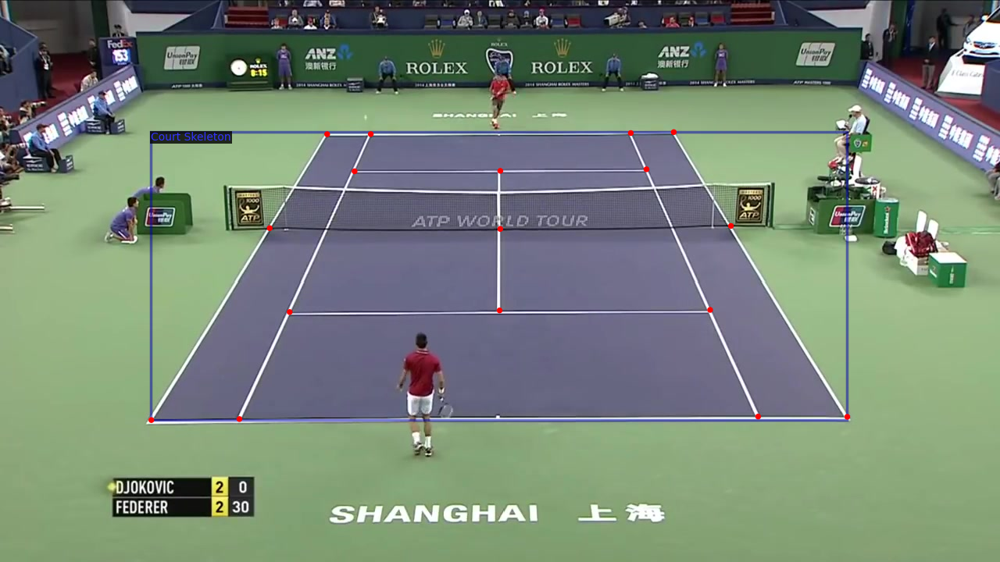

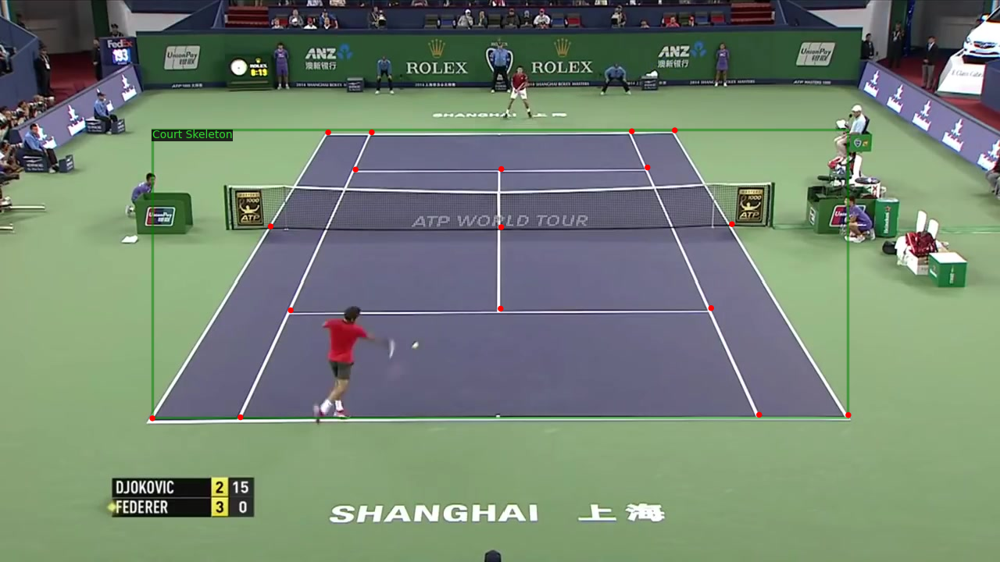

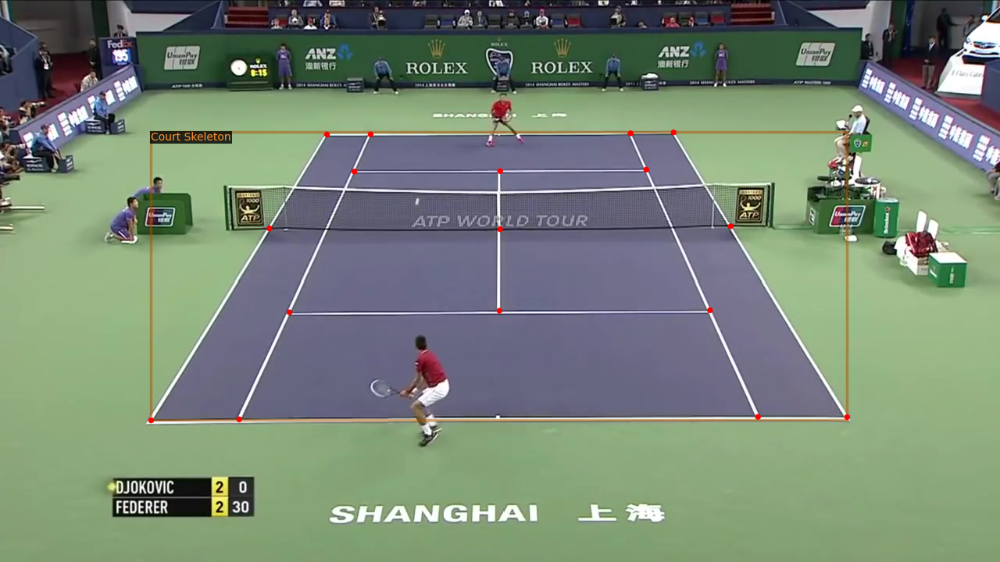

[07/17 22:05:14 d2.data.datasets.coco]: Loaded 1001 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game2.json

 Visualizing samples from game2



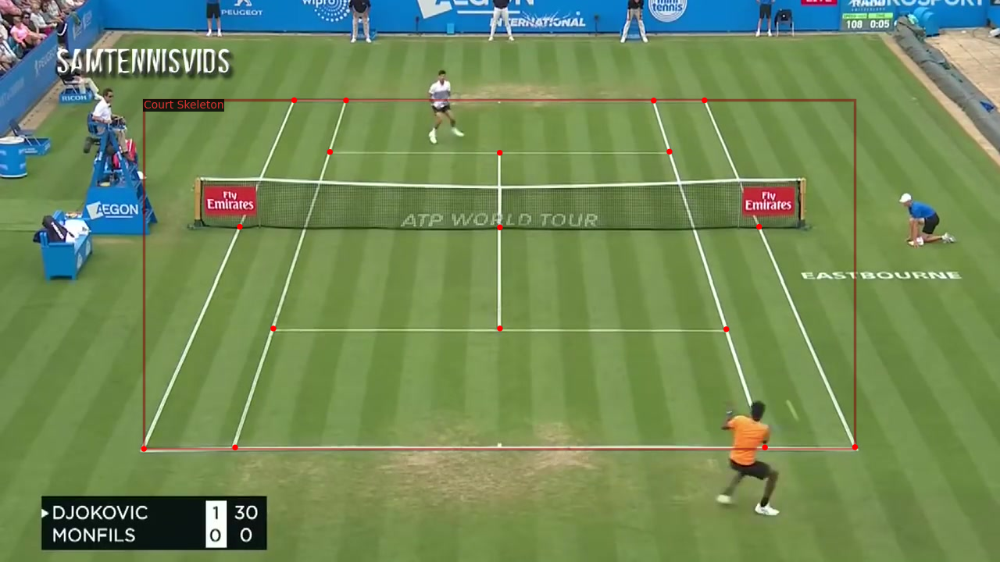

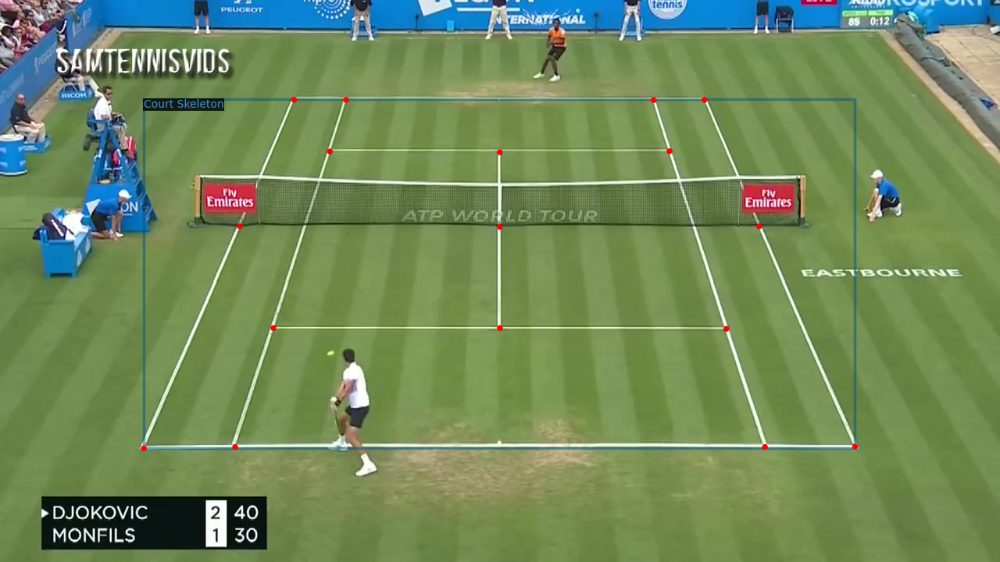

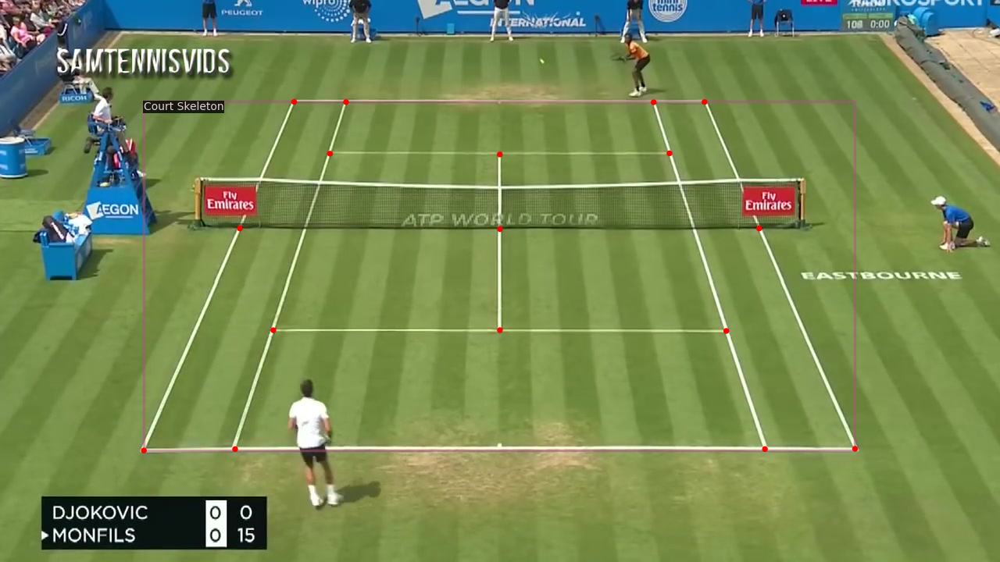

[07/17 22:05:16 d2.data.datasets.coco]: Loaded 1558 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game3.json

 Visualizing samples from game3



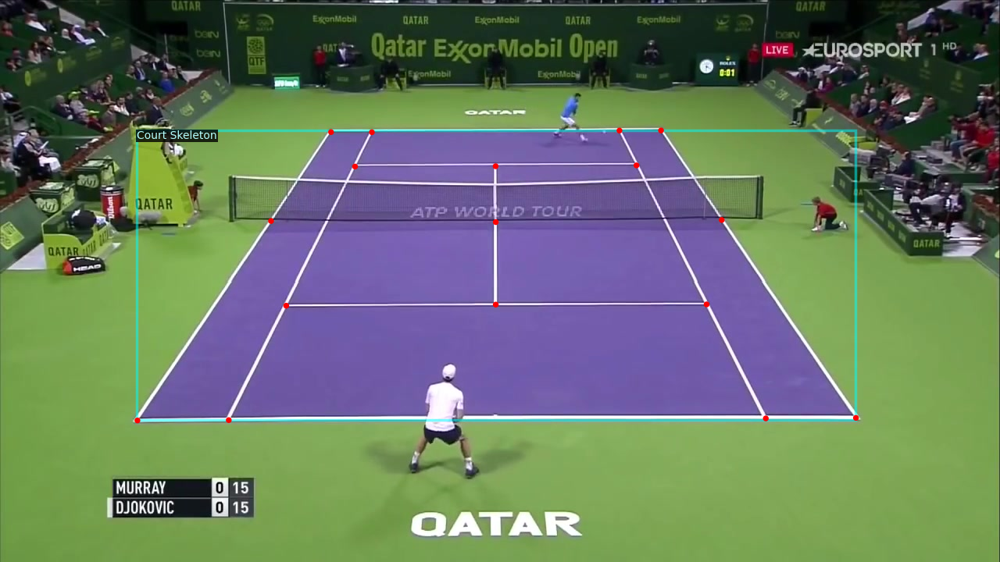

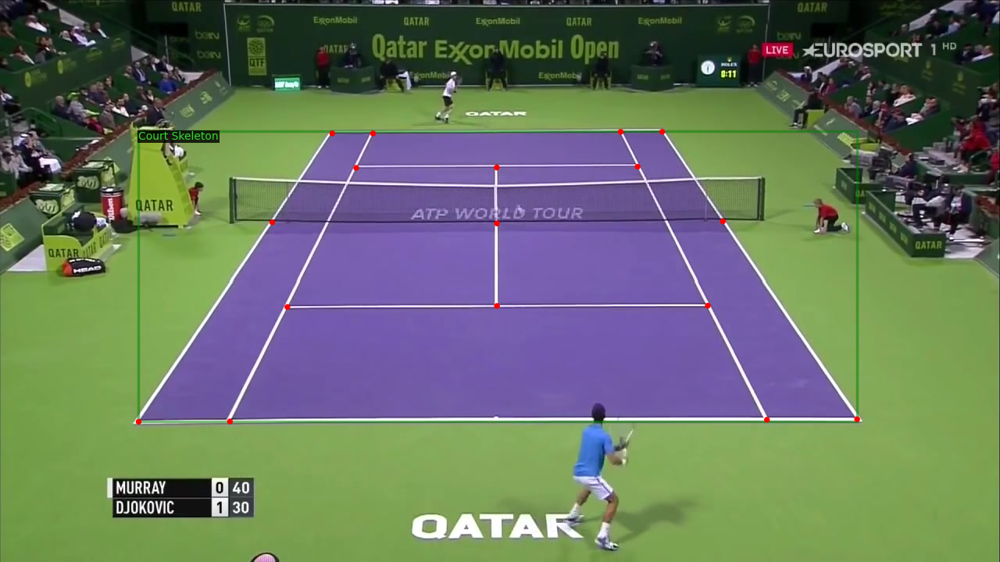

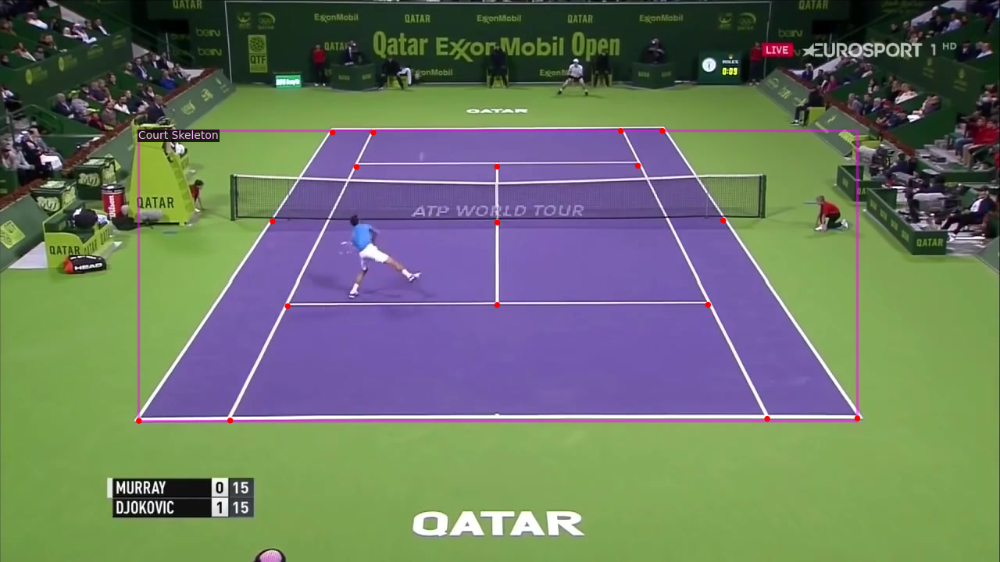

[07/17 22:05:19 d2.data.datasets.coco]: Loaded 1200 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game4.json

 Visualizing samples from game4



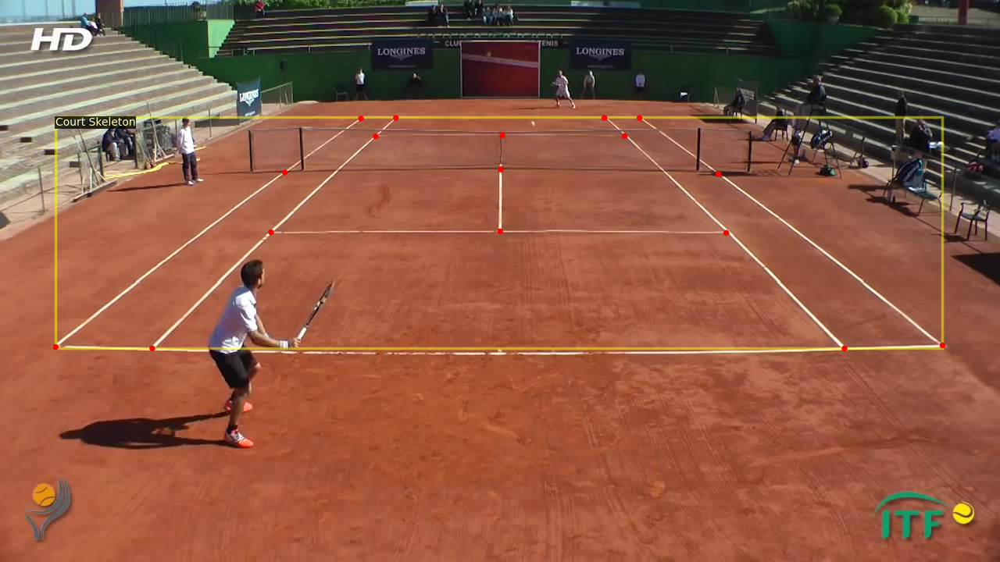

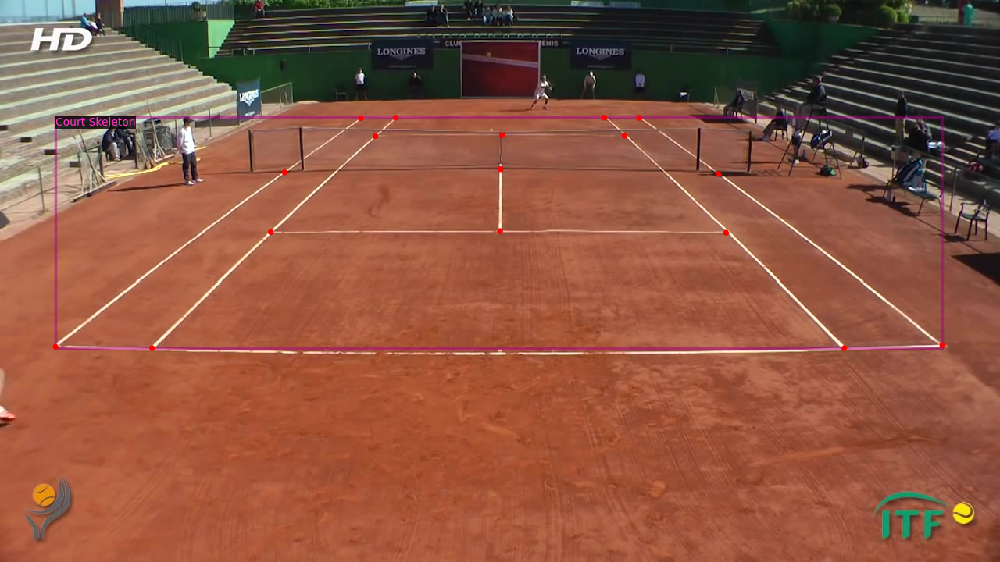

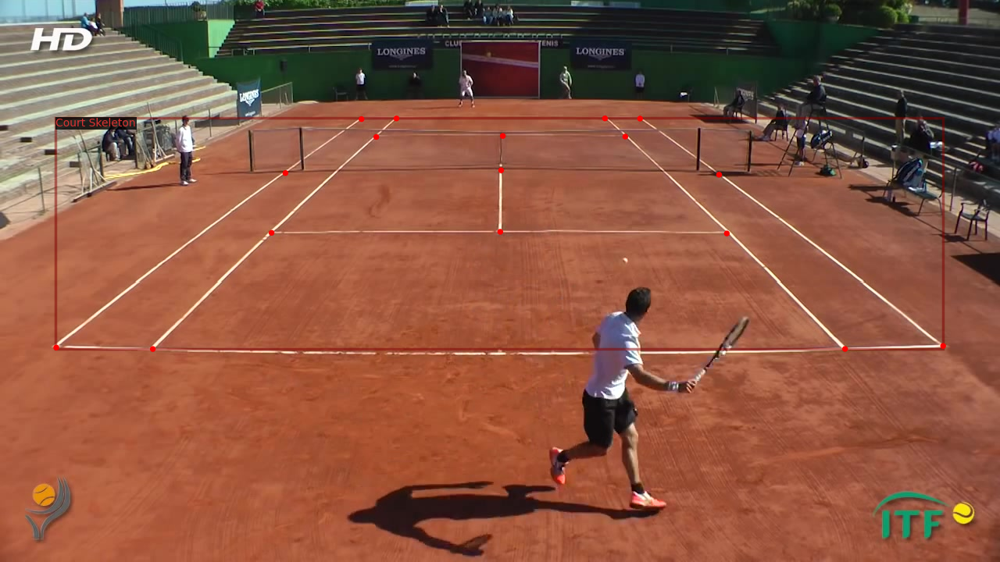

[07/17 22:05:21 d2.data.datasets.coco]: Loaded 1200 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game5.json

 Visualizing samples from game5



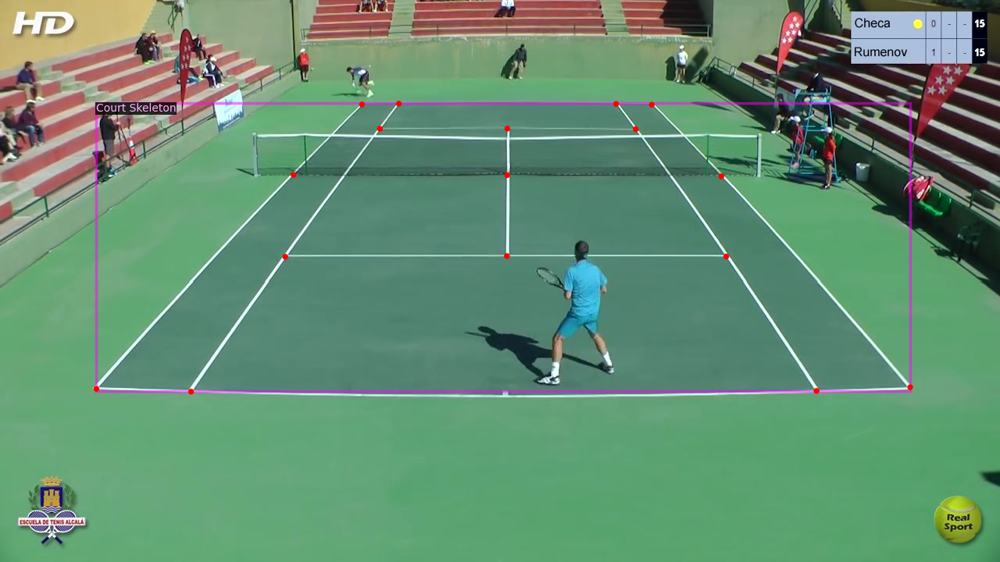

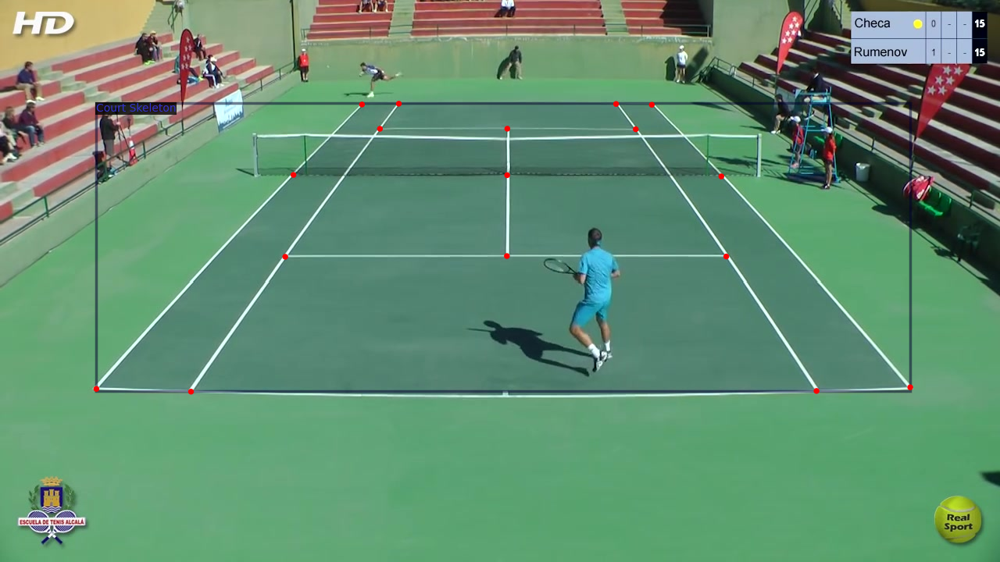

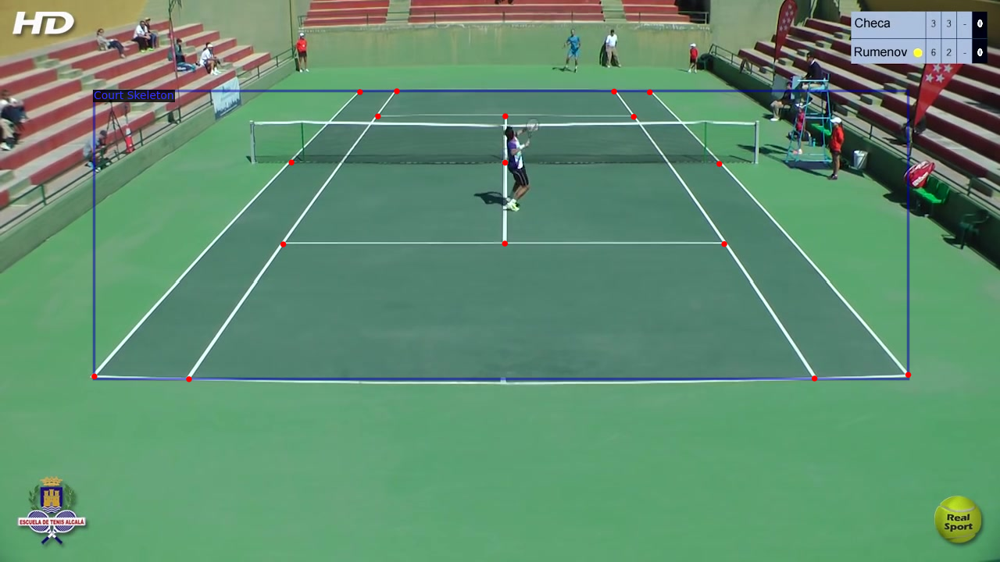

[07/17 22:05:24 d2.data.datasets.coco]: Loaded 1300 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game6.json

 Visualizing samples from game6



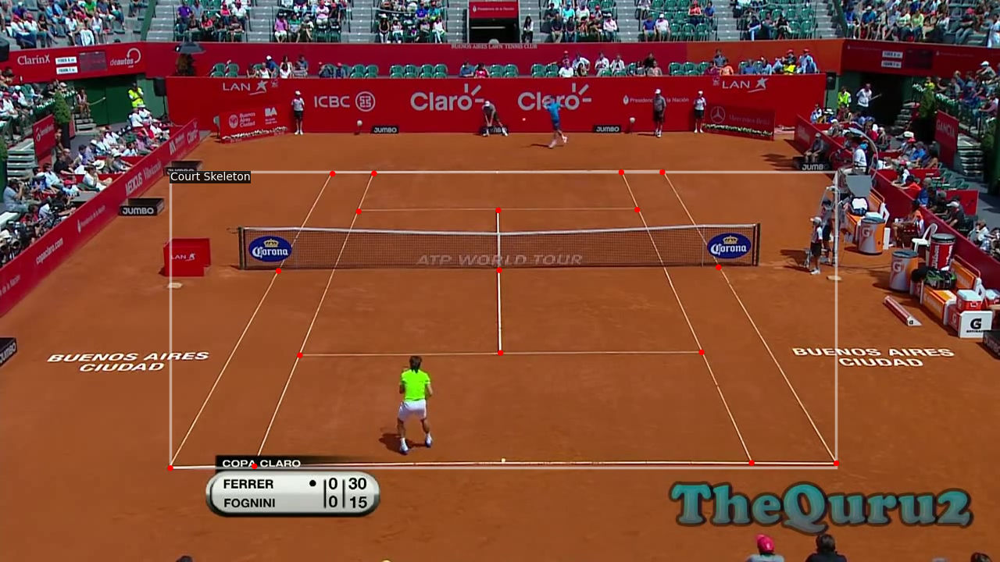

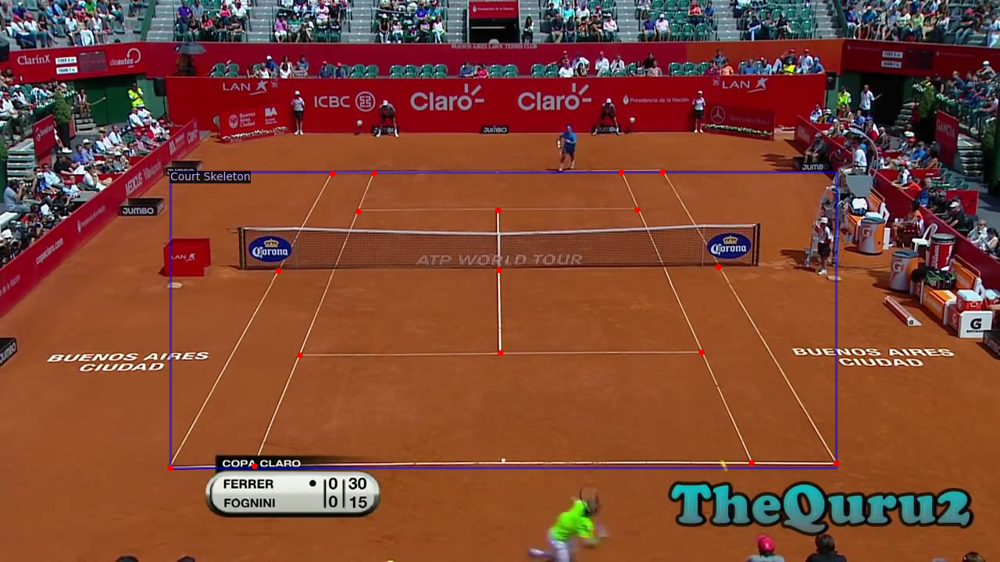

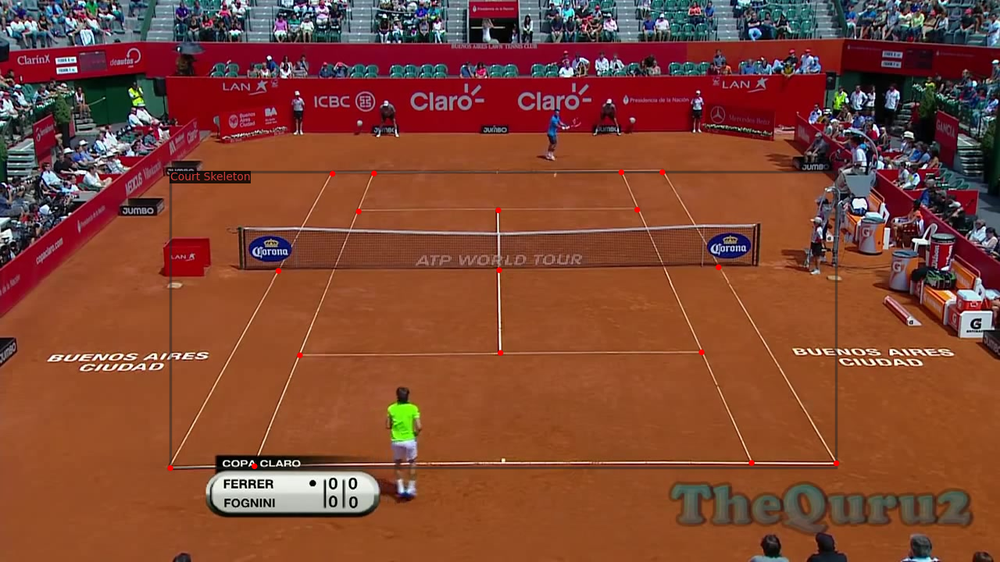

[07/17 22:05:26 d2.data.datasets.coco]: Loaded 1300 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game7.json

 Visualizing samples from game7



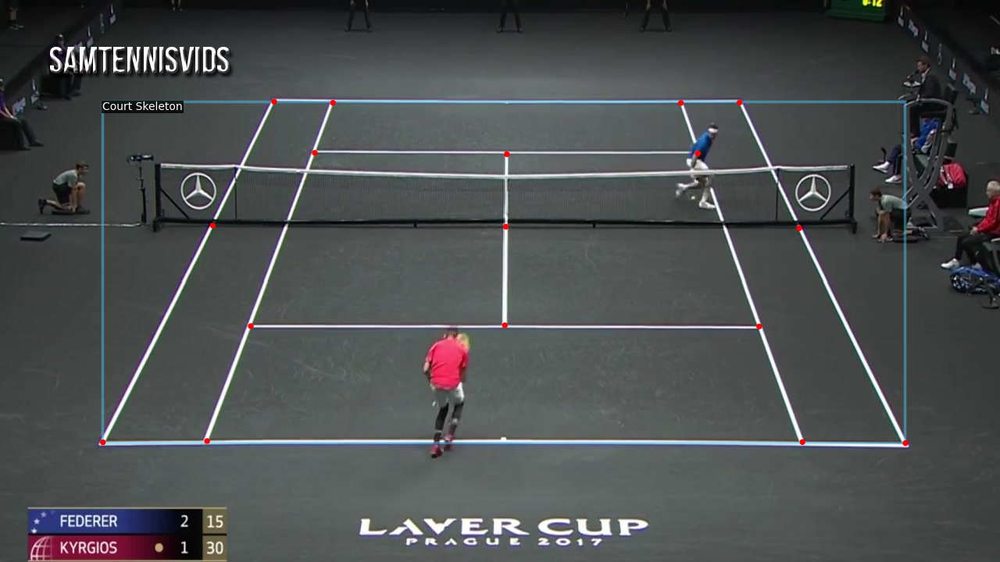

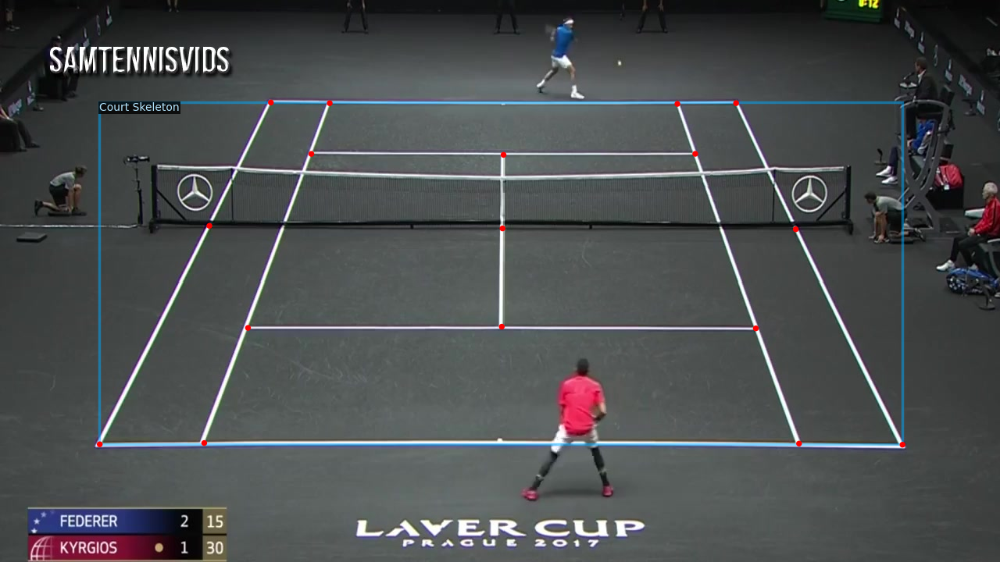

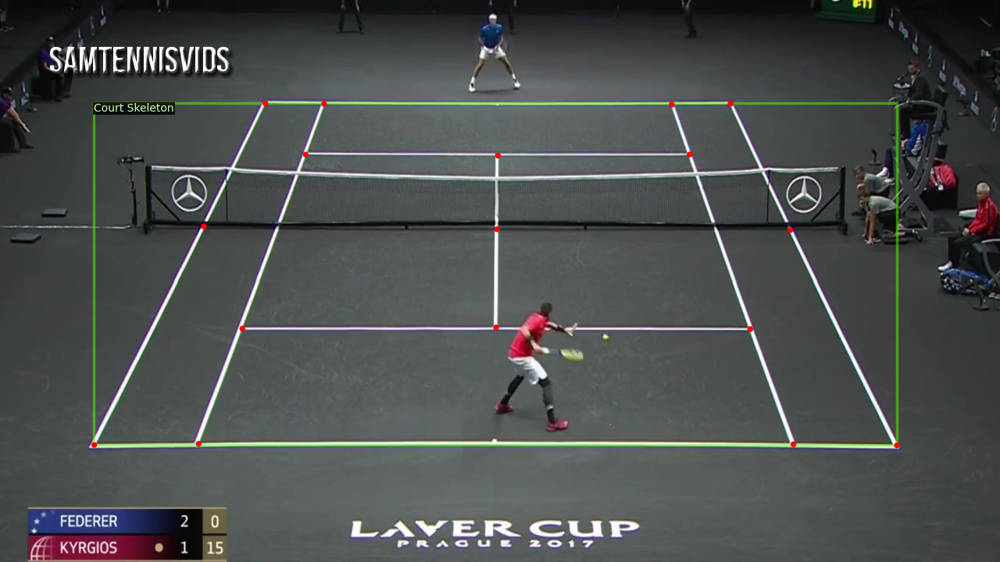

[07/17 22:05:28 d2.data.datasets.coco]: Loaded 1958 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game8.json

 Visualizing samples from game8



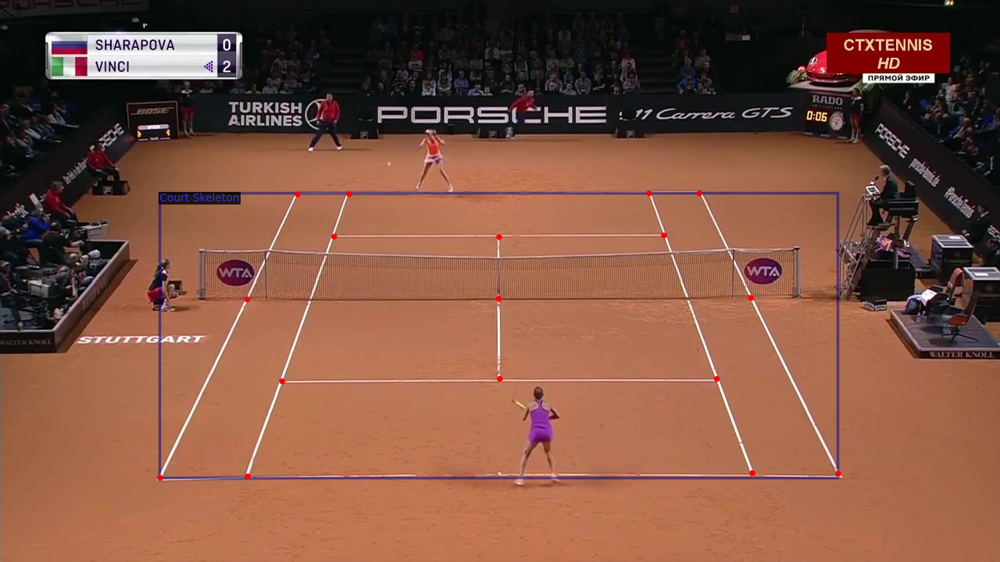

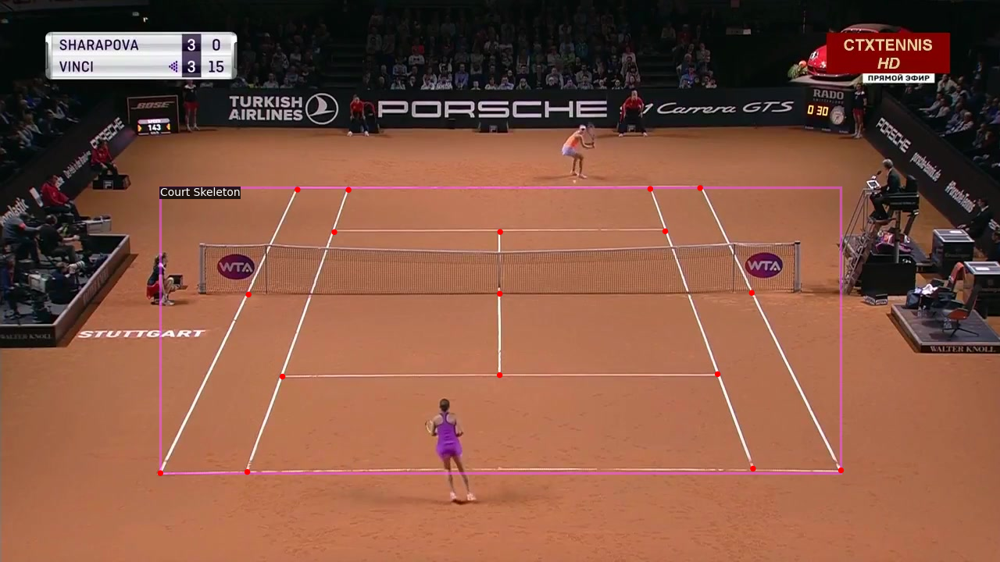

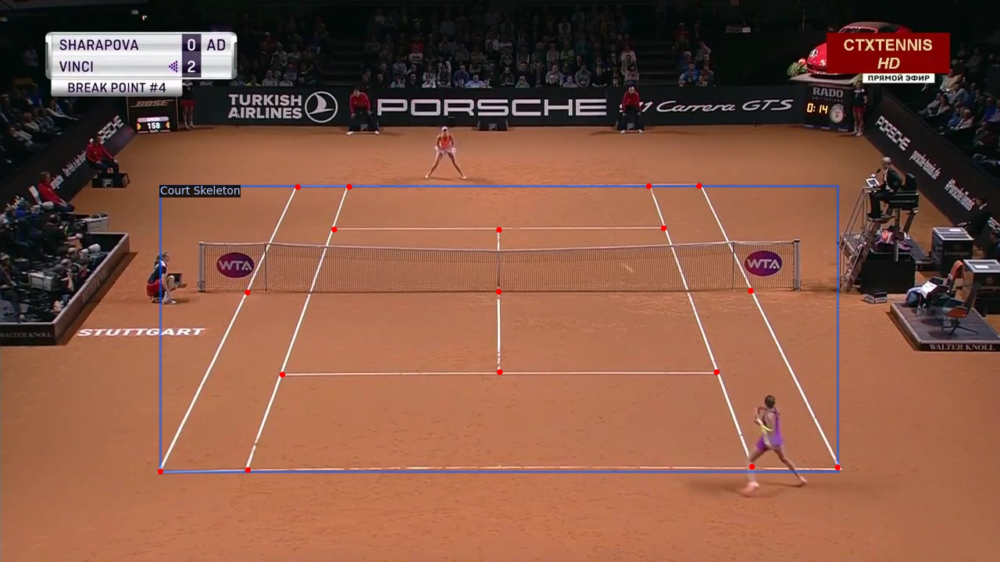

[07/17 22:05:30 d2.data.datasets.coco]: Loaded 1573 images in COCO format from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game9.json

 Visualizing samples from game9



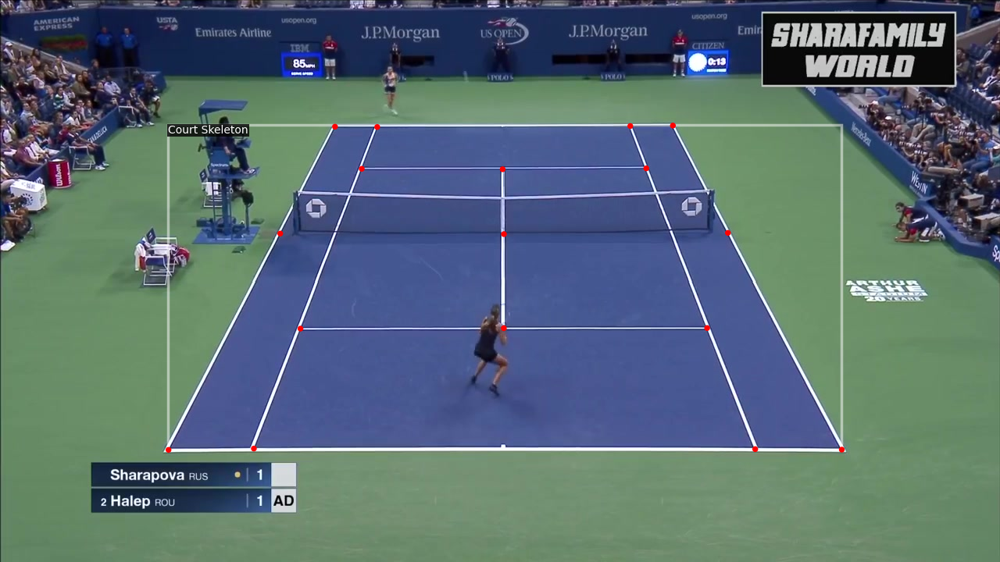

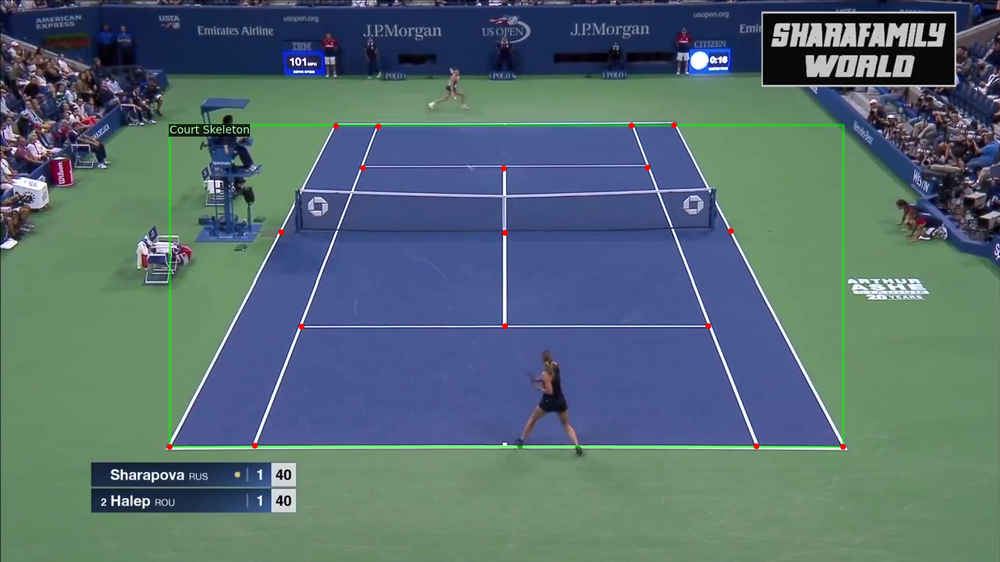

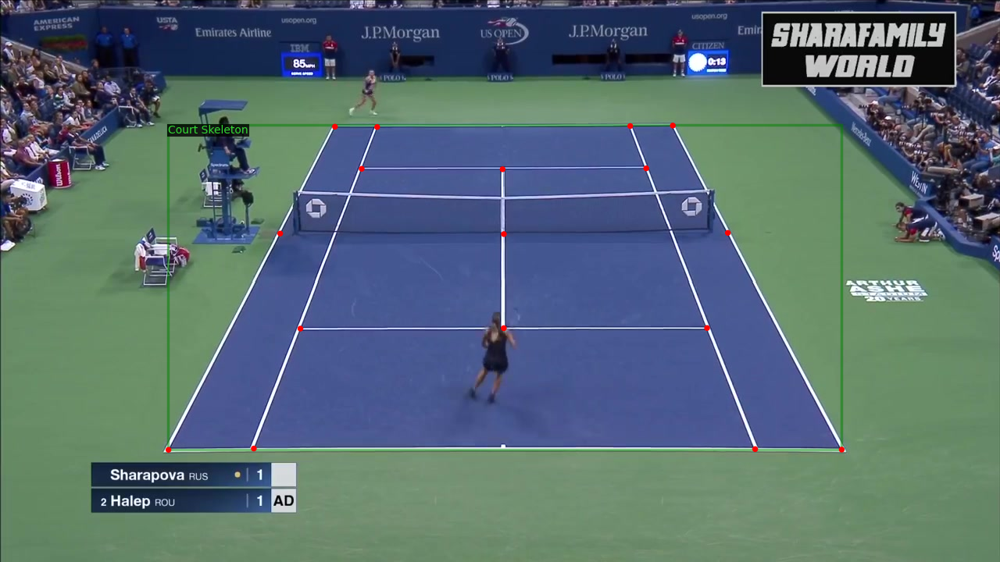

In [ ]:

def visualize_random_samples(json_files, image_dirs):
    for json_file, image_dir in zip(json_files, image_dirs):
        dataset_name = os.path.basename(json_file).split('.')[0]
        metadata = MetadataCatalog.get(dataset_name)
        dataset_dicts = DatasetCatalog.get(dataset_name)

        print(f"\n Visualizing samples from {dataset_name}\n")
        for d in random.sample(dataset_dicts, 3):
            img = cv2.imread(d["file_name"])
            visualizer = Visualizer(img[:, :, ::-1], metadata=metadata, scale=1.0)
            vis = visualizer.draw_dataset_dict(d)
            cv2_imshow(vis.get_image()[:, :, ::-1])
            cv2.waitKey(0)
            cv2.destroyAllWindows()

visualize_random_samples(train_json_files, train_image_dirs)
visualize_random_samples(val_json_files, val_image_dirs)


## Model Training

In this section, we will define the keypoint metadata, unregister and register the datasets, and set up the custom trainer and training function for the Detectron2 model.


### Custom Trainer and Training Function

This function sets up the configuration for the model, registers the datasets, and trains the model incrementally. It allows resuming training from the last checkpoint and specifies the maximum number of iterations for each session.

#### Training Config


- `DATASETS.TRAIN`: Specifies the training datasets.
- `DATASETS.TEST`: Specifies the validation datasets.
- `DATALOADER.NUM_WORKERS`: Number of data loading workers.
- `SOLVER.IMS_PER_BATCH`: Number of images per batch.
- `SOLVER.BASE_LR`: Base learning rate.
- `SOLVER.MAX_ITER`: Total number of iterations for training.
- `SOLVER.STEPS`: Steps to decay the learning rate.
- `SOLVER.GAMMA`: Factor by which the learning rate is decayed.
- `SOLVER.CHECKPOINT_PERIOD`: Number of iterations between checkpoints.
- `MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE`: Number of regions of interest (ROIs) per image for training.
- `MODEL.ROI_HEADS.NUM_CLASSES`: Number of classes in the dataset.

#### Explanation for Current Setup
- Training Data: Uses games 1 to 6.
- Validation Data: Uses games 7 to 9.
- Incremental Training: Allows for incremental training by adding more games to the training dataset as needed.
- Resuming Training: Can resume training from the last checkpoint.

In [ ]:
# Custom trainer with evaluator
class TrainerWithEval(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
        return COCOEvaluator(dataset_name, cfg, True, output_folder)

# Function to set up and train the model with mixed datasets incrementally
def train_model(max_iter, resume=False):
    register_datasets(train_json_files, train_image_dirs, "tennis_game_train")
    register_datasets(val_json_files, val_image_dirs, "tennis_game_val")

    # register_coco_instances(f"tennis_game_train", {}, train_json_files, train_image_dirs)
    # register_coco_instances(f"tennis_game_val", {}, val_json_files, val_image_dirs)

    # MetadataCatalog.get(f"tennis_game_train").keypoint_names = keypoint_names
    # MetadataCatalog.get(f"tennis_game_train").keypoint_flip_map = keypoint_flip_map
    # MetadataCatalog.get(f"tennis_game_train").keypoint_connection_rules = skeleton

    # MetadataCatalog.get(f"tennis_game_val").keypoint_names = keypoint_names
    # MetadataCatalog.get(f"tennis_game_val").keypoint_flip_map = keypoint_flip_map
    # MetadataCatalog.get(f"tennis_game_val").keypoint_connection_rules = skeleton

    cfg = get_cfg()
    cfg.merge_from_file("/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/configs/COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml")
    cfg.DATASETS.TRAIN = tuple([os.path.basename(f).split('.')[0] for f in train_json_files])
    cfg.DATASETS.TEST = tuple([os.path.basename(f).split('.')[0] for f in val_json_files])
    cfg.DATALOADER.NUM_WORKERS = 4
    cfg.SOLVER.IMS_PER_BATCH = 4  # Increase if you have more GPU memory
    cfg.SOLVER.BASE_LR = 0.0001  # Lower learning rate for more careful training
    cfg.SOLVER.MAX_ITER = max_iter  # Total number of iterations
    cfg.SOLVER.STEPS = [int(max_iter*0.75), int(max_iter*0.875)]  # Decay learning rate
    cfg.SOLVER.GAMMA = 0.1  # Decay factor
    cfg.SOLVER.CHECKPOINT_PERIOD = 20000  # Save a checkpoint every 20000 iterations
    cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256  # Increase for more stable gradients
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 11  # Your dataset has 11 classes

    output_dir = f"/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model"
    cfg.OUTPUT_DIR = output_dir
    os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

    trainer = TrainerWithEval(cfg)
    trainer.resume_or_load(resume=resume)
    trainer.train()


### Train the Model

Set the session number and iteration intervals to control the training process.

#### Instructions for Future Use

1. Adjusting the Dataset: Modify train_json_files and train_image_dirs to include the desired games for training. Similarly, adjust val_json_files and val_image_dirs for validation games.

2. Changing the Session Number: Update session_number to change your training session after each time.

3. Setting Iterations: Adjust max_iter for the total number of training iterations.
Resuming Training: Set resume to True if resuming from the last checkpoint.

In [ ]:
# Function to print the session number
def print_session_number(session_number):
    print(f"Current Session Number: {session_number}")

# Function to print the last iteration where the model left off
def print_last_iteration(output_dir, last_checkpoint):
    checkpoint_path = os.path.join(output_dir, last_checkpoint)
    if os.path.exists(checkpoint_path):
        checkpoint = torch.load(checkpoint_path, map_location=torch.device('cpu'))
        last_iter = checkpoint.get('iteration', 'unknown')
        print(f"Last Iteration: {last_iter + 1}")
    else:
        print("No previous checkpoint found.")
        last_iter = 0
    return last_iter

# Set the session number and iteration intervals
output_dir = "/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model"
last_checkpoint = "model_final.pth"

# Print the session number and last iteration
print_session_number(session_number)
last_iter = print_last_iteration(output_dir, last_checkpoint)


Current Session Number: 8
Last Iteration: 164000


In [ ]:
# Instructions for Future Use
# 1. Adjusting the Dataset: Modify `train_json_files` and `train_image_dirs` to include the desired games for training.
#    Similarly, adjust `val_json_files` and `val_image_dirs` for validation games.
# 2. Changing the Session Number: Update `session_number` to change your training session after each time.
# 3. Setting Iterations: Adjust `max_iter` for the total number of training iterations. Resuming Training: Set `resume` to True if resuming from the last checkpoint.

# Training parameters
custom_iter = 50000  # Adjust this to your custom number of iterations per session
max_iter = last_iter + custom_iter  # Change this for the number of iterations per session

In [ ]:

# Execute to train model
train_model(max_iter, resume=True)


Registered dataset game1 with /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game1.json and /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset/game1/game1_images
Registered dataset game2 with /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game2.json and /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset/game2/game2_images
Registered dataset game3 with /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game3.json and /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset/game3/game3_images
Registered dataset game4 with /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/annotations/model_annotations/games/all_games/game4.json and /content/

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/local/lib/python3.10/dist-packages/detectron2/structures/keypoints.py:29: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:274.)
  keypoints = torch.as_tensor(keypoints, dtype=torch.float32, device=device)
/usr/local/lib/python3.10/dist-packages/detectron2/structures/keypoints.py:29: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:274.)
  keypoints = tor

[07/17 21:45:06 d2.utils.events]:  eta: 5:10:02  iter: 164019  total_loss: 0.1547  loss_cls: 0.0003445  loss_box_reg: 0.0005092  loss_keypoint: 0.1539  loss_rpn_cls: 1.862e-05  loss_rpn_loc: 0.0004208    time: 0.7319  last_time: 0.2633  data_time: 0.5399  last_data_time: 0.0882   lr: 1e-05  max_mem: 7783M
[07/17 21:45:19 d2.utils.events]:  eta: 4:33:27  iter: 164039  total_loss: 0.179  loss_cls: 0.0006523  loss_box_reg: 0.0006162  loss_keypoint: 0.1775  loss_rpn_cls: 1.315e-05  loss_rpn_loc: 0.0005049    time: 0.6723  last_time: 0.3078  data_time: 0.4455  last_data_time: 0.1353   lr: 1e-05  max_mem: 7783M
[07/17 21:45:31 d2.utils.events]:  eta: 4:22:23  iter: 164059  total_loss: 0.177  loss_cls: 0.0005564  loss_box_reg: 0.0005649  loss_keypoint: 0.1758  loss_rpn_cls: 2.207e-05  loss_rpn_loc: 0.0003852    time: 0.6605  last_time: 0.2217  data_time: 0.4651  last_data_time: 0.0494   lr: 1e-05  max_mem: 7783M
[07/17 21:45:40 d2.utils.events]:  eta: 4:22:16  iter: 164079  total_loss: 0.1605

KeyboardInterrupt: 

### Save Metrics

This cell is focused on saving the training logs in a JSON file and graphing the losses (total loss and keypoint loss) over the iterations for a specific training session. Monitoring these losses is crucial as it helps in understanding how well the model is learning and if it is converging properly.

#### Set session number and starting iteration for each session

These variables help in specifying which session is currently being processed and the range of iterations to consider.

In [ ]:

# Function to load metrics from the metrics file
def load_metrics(metrics_file):
    metrics = []
    with open(metrics_file, 'r') as f:
        for line in f:
            metrics.append(json.loads(line))
    return metrics

# Function to save metrics and plot the graph for the current session
def save_metrics_and_graph(session_number, metrics_file, last_iter, max_iter):
    metrics = load_metrics(metrics_file)

    # Filter metrics to include only those within the current session range
    filtered_metrics = [x for x in metrics if last_iter <= x['iteration'] < max_iter]

    # Extract iterations, total_loss, and keypoint_loss
    iterations = [x['iteration'] for x in filtered_metrics if 'iteration' in x]
    total_loss = [x['total_loss'] for x in filtered_metrics if 'total_loss' in x]
    keypoint_loss = [x['loss_keypoint'] for x in filtered_metrics if 'loss_keypoint' in x]

    # Ensure that the lengths are the same
    min_length = min(len(iterations), len(total_loss), len(keypoint_loss))
    iterations = iterations[:min_length]
    total_loss = total_loss[:min_length]
    keypoint_loss = keypoint_loss[:min_length]

    # Plot the metrics with the correct iteration numbers
    plt.figure(figsize=(10, 5))
    plt.plot(iterations, total_loss, label='Total Loss')
    plt.plot(iterations, keypoint_loss, label='Keypoint Loss')
    plt.xlabel('Iteration')
    plt.ylabel('Loss')
    plt.title(f'Loss over Iterations (Session {session_number})')
    plt.legend()
    plt.grid(True)

    # Create session directory if it doesn't exist
    session_dir = f"/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/logs/session{session_number}"
    os.makedirs(session_dir, exist_ok=True)

    # Save the plot
    plot_path = os.path.join(session_dir, f'loss_graph_session{session_number}.png')
    plt.savefig(plot_path)
    plt.close()

    # Save the metrics
    log_path = os.path.join(session_dir, f'metrics_session{session_number}.json')
    with open(log_path, 'w') as f:
        json.dump(filtered_metrics, f, indent=4)

    print(f"Metrics saved to {log_path}")

# Path to the metrics file
metrics_file_path = "/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/metrics.json"

# Save metrics and graph for the current session
save_metrics_and_graph(session_number, metrics_file_path, last_iter, max_iter)


## Post Processing

In this section, we will load the trained model, run it on test data, and visualize the predictions with labeled keypoints and their confidence scores.


### Define Test Games

We define the games we want to test on. You can adjust this list based on your needs.



In [ ]:
num_frames = 1  # Number of frames to visualize per game

# Option 1: Use all available games in the directory
use_all_games = True

# Option 2: Specify a custom dataset path
custom_dataset_path = None  # Set to a valid path if using a custom dataset, else None

# Option 3: Define specific games to test
specific_games = [1, 2, 3]  # Specify game numbers if not using all available games

# Determine test games based on options
if custom_dataset_path:
    test_games = [custom_dataset_path]
elif use_all_games:
    dataset_dir = "/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset"
    test_games = [int(folder.split('game')[-1]) for folder in os.listdir(dataset_dir) if folder.startswith('game')]
else:
    test_games = specific_games

In [ ]:
print(test_games)

[1, 2, 3, 4, 5, 6, 7, 8, 9]


### Visualization and Video Creation for Tennis Keypoints Detection

This section of the code is responsible for visualizing keypoints on tennis court images and creating videos from these visualized frames.

#### Key Components:

1. **`visualize_predictions_with_labels`**:
    - FOR TESTING PURPOSES ONLY
    - Visualizes keypoints detected on an image with their labels and scores.
    - Filters to keep only the most confident instance.
    - Draws labels and scores next to each keypoint.

2. **`visualize_random_frames`**:
    - Selects random frames from the dataset and visualizes the keypoints and their connections.
    - Useful for visually verifying the accuracy of keypoint detection on random samples.

3. **`create_video_from_frames`**:
    - Creates a video by visualizing keypoints on each frame of the dataset.
    - Saves the video to a specified output directory.
    - Calls the `visualize_predictions_with_lines` function to generate visualized frames.

4. **Main Function**:
    - Iterates over each game in `test_games`.
    - For each game, loads the model and dataset paths.
    - Calls `create_video_from_frames` to generate and save videos.

### Usage:

- **Visualize Predictions**: Calls `visualize_predictions_with_labels` to show keypoints and labels on images.
- **Create Video**: Uses `create_video_from_frames` to process and save videos for each dataset game.
- **Directory Path**: Videos are saved in `/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/post_processing/session{session_number}/game{game_number}`.


In [ ]:
# Ensure logging is set up
import logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Utility function to get paths based on session number and game number
def get_paths(session_number, game_number):
    config_path = "/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/configs/COCO-Keypoints/keypoint_rcnn_R_50_FPN_3x.yaml"
    model_weights = f"/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth"
    dataset_name = f"tennis_game_train"
    dataset_path = f"/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/dataset/game{game_number}/game{game_number}_images"
    return config_path, model_weights, dataset_name, dataset_path

# Utility function to load the trained model
def load_model(config_path, model_weights, dataset_name):
    cfg = get_cfg()
    cfg.merge_from_file(config_path)
    cfg.MODEL.WEIGHTS = model_weights
    cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
    cfg.MODEL.ROI_HEADS.NUM_CLASSES = 11  # Ensure the number of classes matches your dataset
    cfg.MODEL.KEYPOINT_ON = True
    cfg.DATASETS.TEST = (dataset_name,)
    cfg.MODEL.DEVICE = "cuda"

    MetadataCatalog.get(dataset_name).keypoint_names = keypoint_names
    MetadataCatalog.get(dataset_name).keypoint_flip_map = keypoint_flip_map
    MetadataCatalog.get(dataset_name).keypoint_connection_rules = skeleton

    predictor = DefaultPredictor(cfg)
    return predictor



lines = [
    ("BTL", "BTLI"), ("BTLI", "BTRI"), ("BTL", "NL"), ("BTLI", "ITL"),
    ("BTRI", "BTR"), ("BTR", "NR"), ("BTRI", "ITR"),
    ("ITL", "ITM"), ("ITM", "ITR"), ("ITL", "IBL"), ("ITM", "NM"), ("ITR", "IBR"),
    ("NL", "NM"), ("NL", "BBL"), ("NM", "IBM"), ("NR", "BBR"), ("NM", "NR"),
    ("IBL", "IBM"), ("IBM", "IBR"), ("IBL", "BBLI"), ("IBR", "BBRI"),
    ("BBR", "BBRI"), ("BBRI", "BBLI"), ("BBL", "BBLI")
]

line_colors = [(0, 255, 0)] * len(lines)

keypoint_history = {name: deque(maxlen=10) for name in keypoint_names}

def stabilize_keypoints(keypoints):
    stabilized_keypoints = []
    for i, keypoint in enumerate(keypoints):
        keypoint_history[keypoint_names[i]].append(keypoint[:2])
        stabilized_keypoints.append(np.mean(keypoint_history[keypoint_names[i]], axis=0))
    return np.array(stabilized_keypoints)

def visualize_predictions_with_lines(img, predictor, keypoint_names, lines, dataset_name):
    outputs = predictor(img)
    v = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get(dataset_name), scale=0.8, instance_mode=ColorMode.IMAGE)
    instances = outputs["instances"].to("cpu")

    if len(instances) > 0:
        max_conf_idx = instances.scores.argmax()
        instances = instances[max_conf_idx:max_conf_idx + 1]

    out = v.draw_instance_predictions(instances)
    keypoints = instances.pred_keypoints.numpy()[0]
    scores = instances.scores if instances.has("scores") else [1.0]

    label_offset_x = 5
    label_offset_y = -10

    img_copy = img.copy()
    stabilized_keypoints = stabilize_keypoints(keypoints)

    for idx, (keypoints_per_instance, score) in enumerate(zip([stabilized_keypoints], scores)):
        average_kp_score = 0
        for j, keypoint in enumerate(keypoints_per_instance):
            x, y = keypoint
            kp_score = keypoints[j, 2]
            label = keypoint_names[j]
            kp_score = max(0, min(1, kp_score))
            average_kp_score += kp_score
            if kp_score > 0:
                cv2.putText(img_copy, label, (int(x) + label_offset_x, int(y) + label_offset_y),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2, cv2.LINE_AA)
                cv2.circle(img_copy, (int(x), int(y)), 3, (0, 0, 255), -1)

        average_kp_score /= len(keypoints_per_instance)
        average_kp_score = max(0, min(1, average_kp_score)) * 100
        cv2.putText(img_copy, f"Confidence: {average_kp_score:.2f}%", (10, 30 + 30 * idx),
                    cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)

        for (start, end), color in zip(lines, line_colors):
            start_idx = keypoint_names.index(start)
            end_idx = keypoint_names.index(end)
            cv2.line(img_copy, (int(stabilized_keypoints[start_idx][0]), int(stabilized_keypoints[start_idx][1])),
                     (int(stabilized_keypoints[end_idx][0]), int(stabilized_keypoints[end_idx][1])), color, 2)

    return img_copy



#### Testing Model Predictions

This section randomly selects frames from each dataset to visualize model predictions.



- ```def visualize_predictions_with_labels()``` tests keypoints with labels that each have a confidence score
- ```def visualize_frames_with_lines()``` tests keypoints with labels and draws skeletal court lines in between each point







#####  Testing: Visualize Predictions with Labels and Keypoint Scores

This cell primarily focuses on visualizing and verifying the accuracy of the model's predictions by examining random frames from each dataset game.

[07/18 01:10:33 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



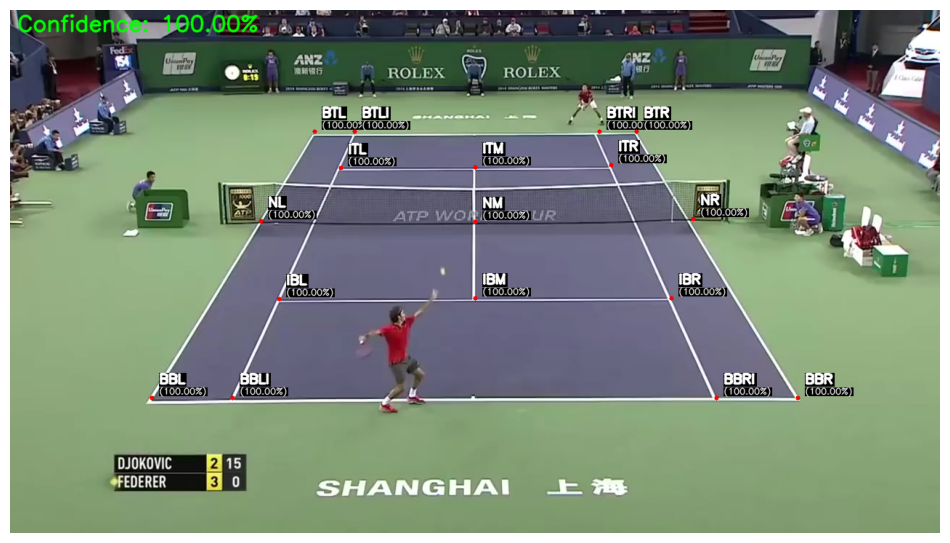

[07/18 01:10:35 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



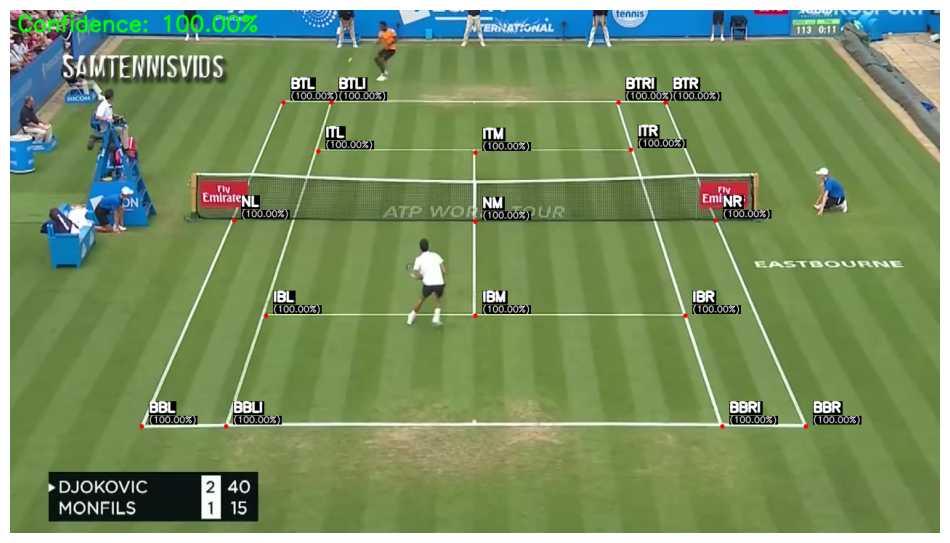

[07/18 01:10:37 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



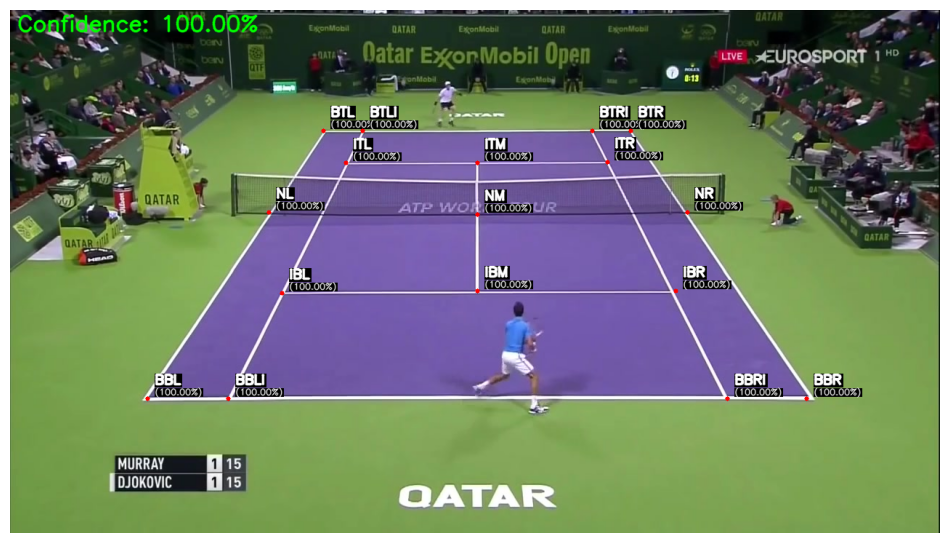

[07/18 01:10:39 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



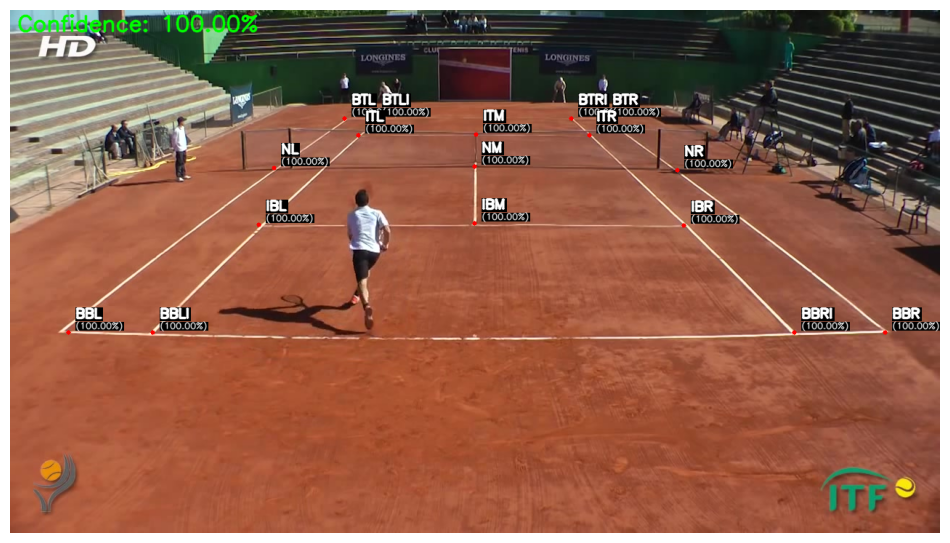

[07/18 01:10:41 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



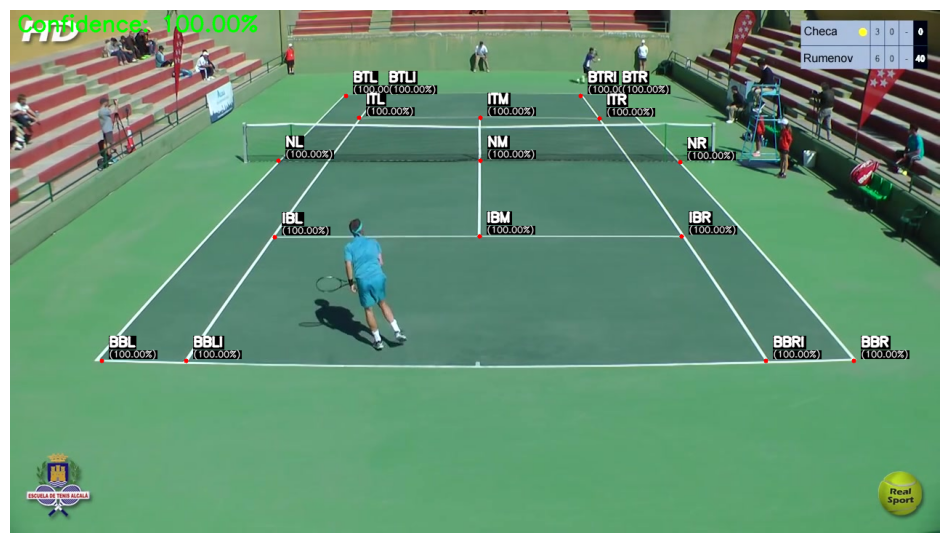

[07/18 01:10:43 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



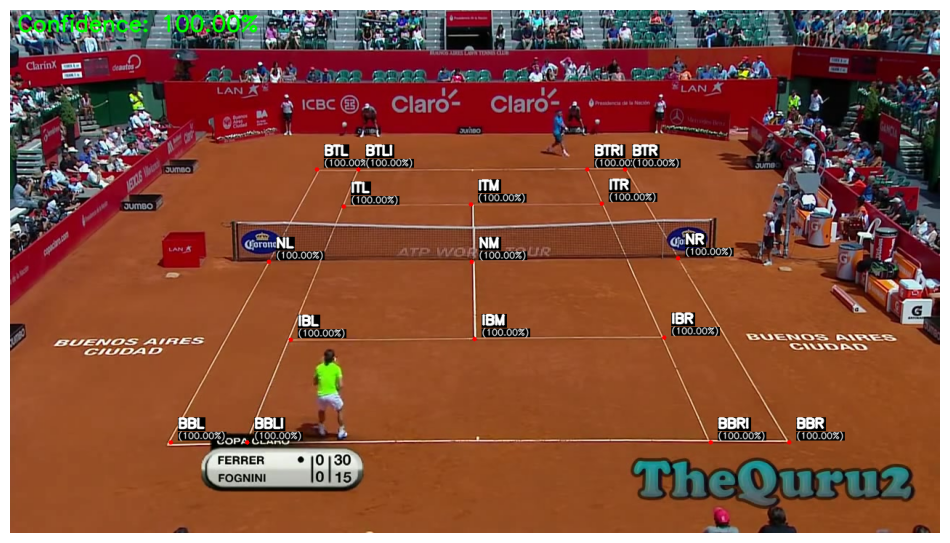

[07/18 01:10:46 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



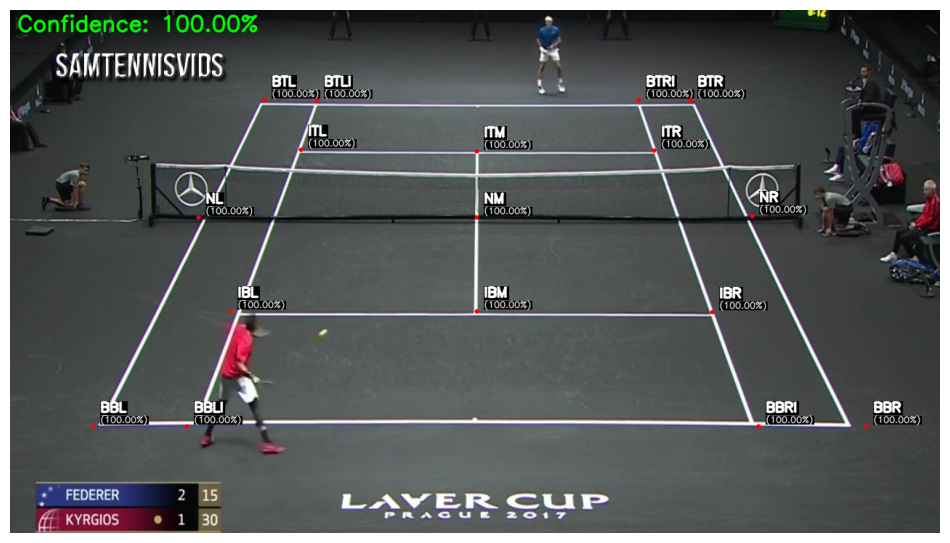

[07/18 01:10:47 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



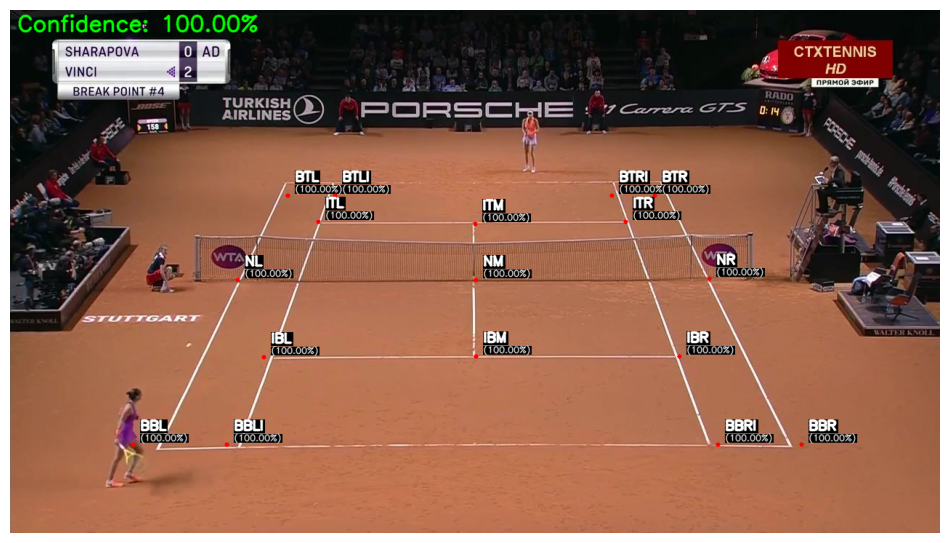

[07/18 01:10:49 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...

 Visualizing samples from tennis_game_train



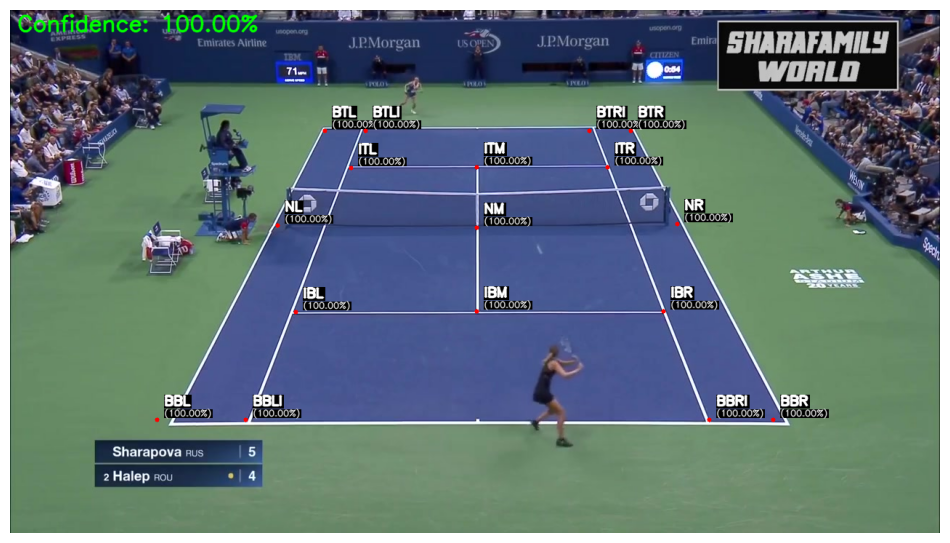

In [ ]:

# TESTING: Test random frames from each dataset to visualize predicted keypoints that each have a confidence score.

# Function to visualize predictions with labels and keypoint scores
def visualize_predictions_with_labels(img, predictor, keypoint_names, dataset_name):
    print(f"\n Visualizing samples from {dataset_name}\n")
    outputs = predictor(img)

    v = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get(dataset_name), scale=0.8, instance_mode=ColorMode.IMAGE)
    instances = outputs["instances"].to("cpu")

    # Filter to keep only the most confident instance
    if len(instances) > 0:
        max_conf_idx = instances.scores.argmax()
        instances = instances[max_conf_idx:max_conf_idx + 1]

    out = v.draw_instance_predictions(instances)

    # Draw keypoints and labels
    keypoints = instances.pred_keypoints
    scores = instances.scores if instances.has("scores") else [1.0] * len(instances)

    label_offset_x = 10  # Horizontal offset for labels
    label_offset_y = -20  # Vertical offset for labels
    percentage_offset_y = -5  # Vertical offset for percentages

    for idx, (keypoints_per_instance, score) in enumerate(zip(keypoints, scores)):
        average_kp_score = 0
        for j, keypoint in enumerate(keypoints_per_instance):
            x, y, kp_score = keypoint
            label = keypoint_names[j]
            kp_score = max(0, min(1, kp_score))  # Clip the score to be within [0, 1]
            average_kp_score += kp_score
            if kp_score > 0:  # Only draw visible keypoints
                # Draw background box for label
                label_text = f"{label}"
                label_size, _ = cv2.getTextSize(label_text, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)
                label_bg_tl = (int(x) + label_offset_x, int(y) + label_offset_y - label_size[1])
                label_bg_br = (int(x) + label_offset_x + label_size[0], int(y) + label_offset_y + 4)
                cv2.rectangle(img, label_bg_tl, label_bg_br, (0, 0, 0), cv2.FILLED)
                cv2.putText(img, label_text, (int(x) + label_offset_x, int(y) + label_offset_y), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (255, 255, 255), 2, cv2.LINE_AA)

                # Draw background box for percentage
                percentage_text = f"({kp_score * 100:.2f}%)"
                percentage_size, _ = cv2.getTextSize(percentage_text, cv2.FONT_HERSHEY_SIMPLEX, 0.4, 1)
                percentage_bg_tl = (int(x) + label_offset_x, int(y) + percentage_offset_y - percentage_size[1])
                percentage_bg_br = (int(x) + label_offset_x + percentage_size[0], int(y) + percentage_offset_y + 2)
                cv2.rectangle(img, percentage_bg_tl, percentage_bg_br, (0, 0, 0), cv2.FILLED)
                cv2.putText(img, percentage_text, (int(x) + label_offset_x, int(y) + percentage_offset_y), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (255, 255, 255), 1, cv2.LINE_AA)

                cv2.circle(img, (int(x), int(y)), 3, (0, 0, 255), -1)

        # Compute average keypoint score
        average_kp_score /= len(keypoints_per_instance)
        cv2.putText(img, f"Confidence: {average_kp_score * 100:.2f}%", (10, 30 + 30 * idx), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)

    return img

# Visualize random frames
def visualize_random_frames(dataset_path, predictor, keypoint_names, dataset_name, num_frames):
    image_files = sorted([f for f in os.listdir(dataset_path) if f.endswith('.jpg')])
    selected_files = random.sample(image_files, num_frames)

    for image_file in selected_files:
        image_path = os.path.join(dataset_path, image_file)
        img = cv2.imread(image_path)
        visualized_img = visualize_predictions_with_labels(img, predictor, keypoint_names, dataset_name)

        # Display the frame
        plt.figure(figsize=(12, 8))
        plt.imshow(cv2.cvtColor(visualized_img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()

# Iterate over each game and visualize random frames
for game_number in test_games:
    config_path, model_weights, dataset_name, dataset_path = get_paths(session_number, game_number)
    predictor = load_model(config_path, model_weights, dataset_name)
    visualize_random_frames(dataset_path, predictor, keypoint_names, dataset_name, num_frames)



#####  Testing: Visualize Predictions with Labels and lines between keypoints

This cell is focused on testing the visualization of predicted keypoints and drawing lines between them for selected random frames from each dataset game.

[07/18 00:27:19 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


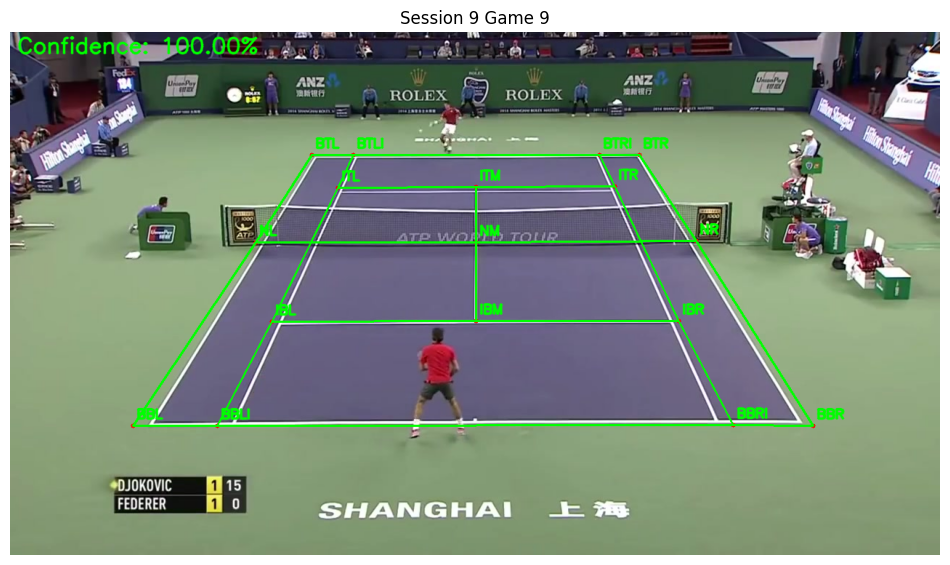

[07/18 00:27:21 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


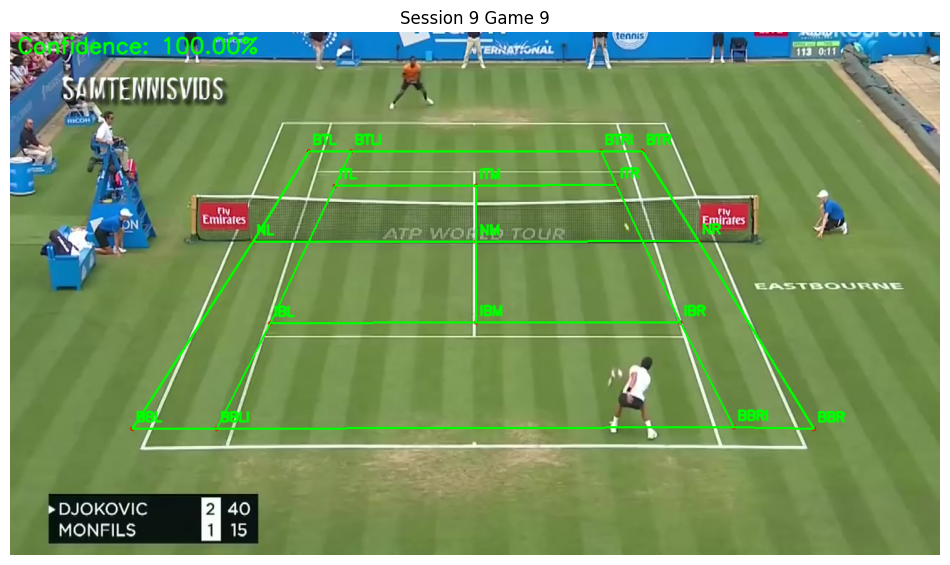

[07/18 00:27:23 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


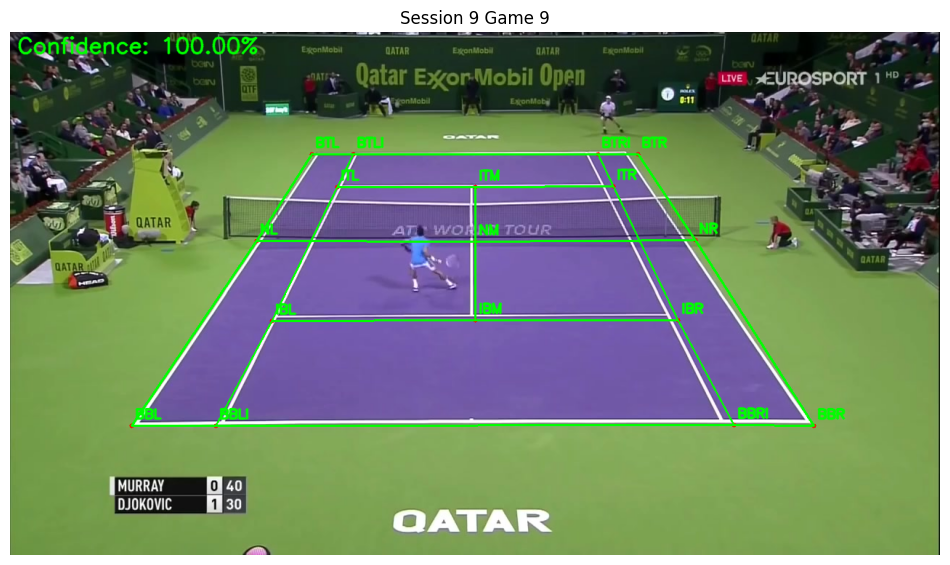

[07/18 00:27:25 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


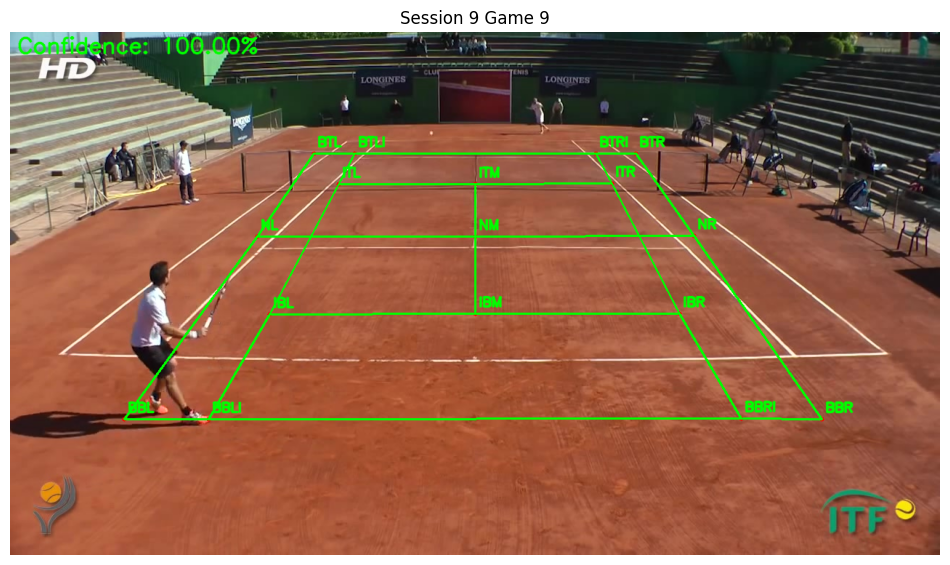

[07/18 00:27:28 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


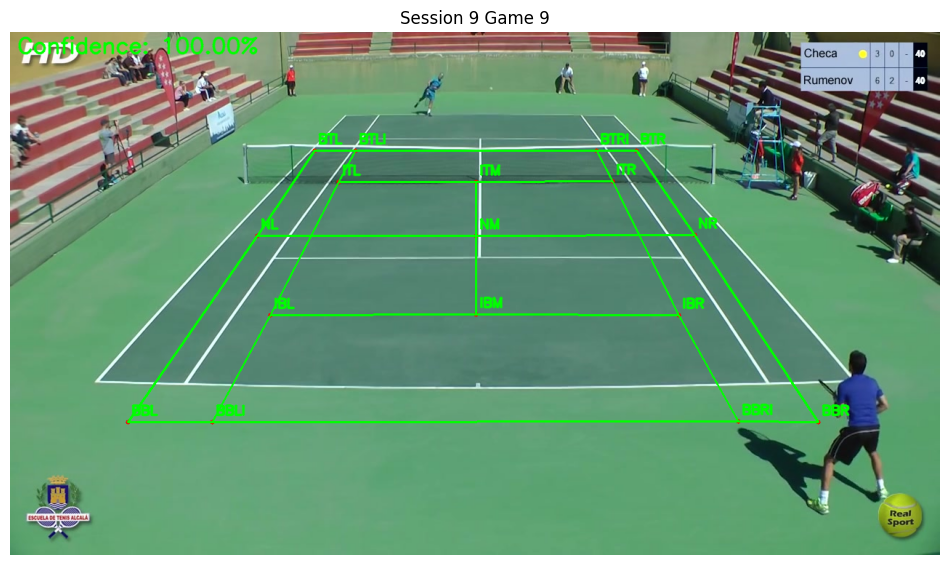

[07/18 00:27:30 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


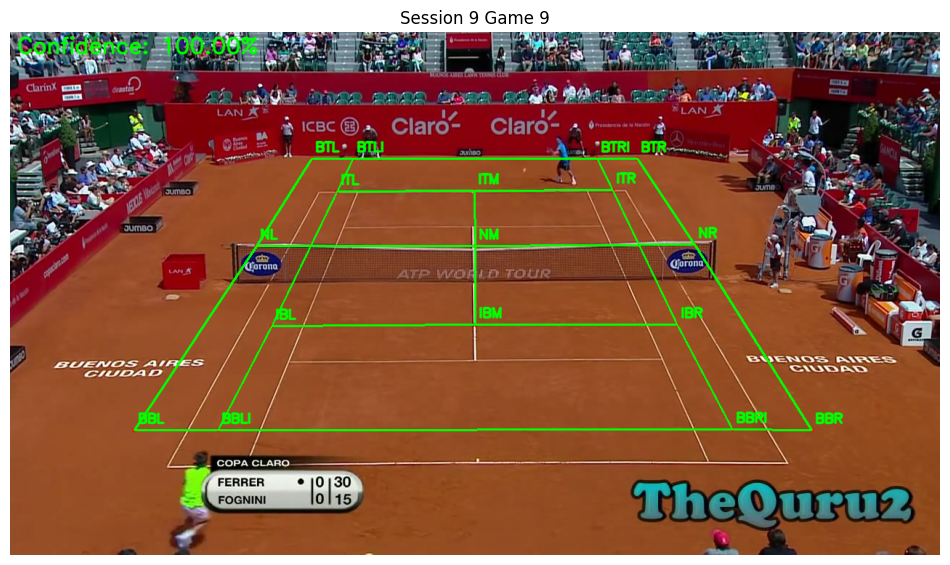

[07/18 00:27:33 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


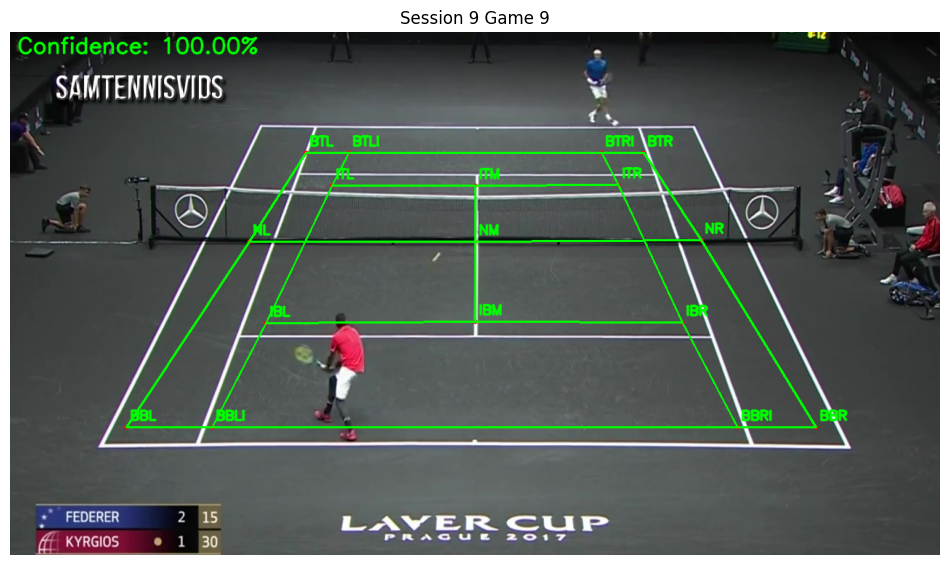

[07/18 00:27:35 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


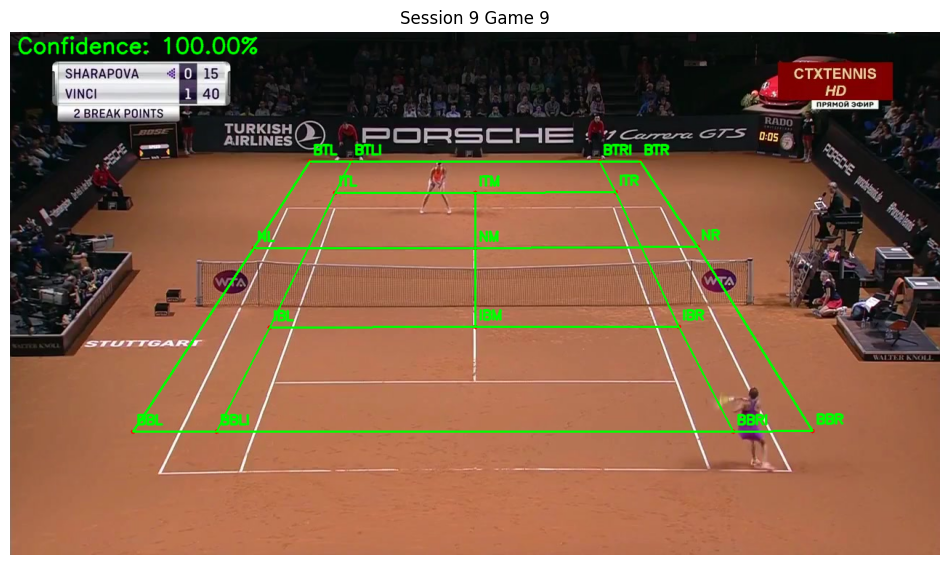

[07/18 00:27:37 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


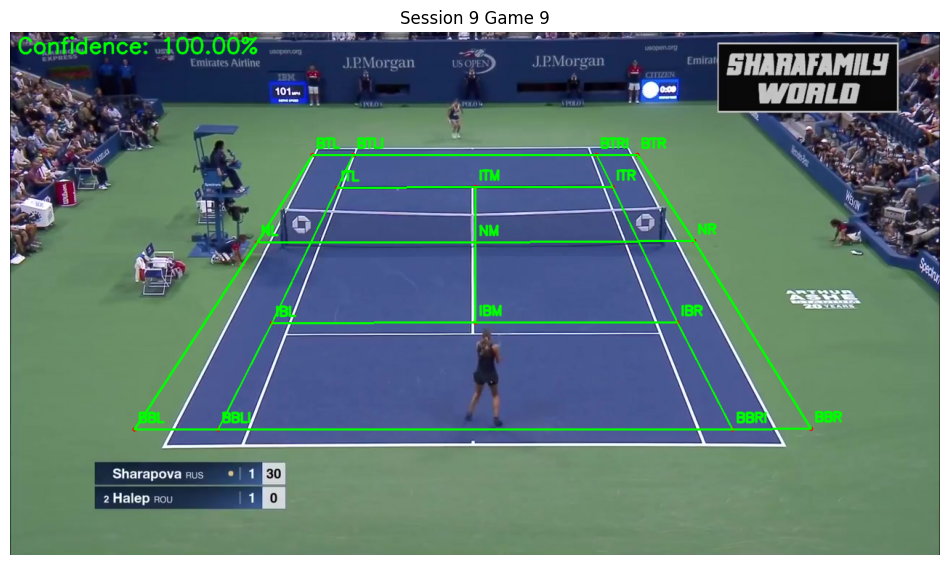

In [ ]:

# TESTING: Test random frames from each dataset to visualize predicted keypoints and draw lines between each keypoint.

# Function to visualize frames
def visualize_frames_with_lines(dataset_path, predictor, keypoint_names, lines, num_frames, dataset_name):
    image_files = sorted([f for f in os.listdir(dataset_path) if f.endswith('.jpg')])
    selected_files = random.sample(image_files, num_frames)

    for image_file in selected_files:
        img_path = os.path.join(dataset_path, image_file)
        img = cv2.imread(img_path)
        if img is None:
            continue
        visualized_img = visualize_predictions_with_lines(img, predictor, keypoint_names, lines, dataset_name)

        plt.figure(figsize=(12, 8))
        plt.imshow(cv2.cvtColor(visualized_img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.title(f"Session {session_number} Game {game_number}")
        plt.show()

# Main function to visualize frames for each game
def main():
    for game_number in test_games:
        config_path, model_weights, dataset_name, dataset_path = get_paths(session_number, game_number)
        predictor = load_model(config_path, model_weights, dataset_name)
        visualize_frames_with_lines(dataset_path, predictor, keypoint_names, lines, num_frames, dataset_name)

# Run the main function
if __name__ == "__main__":
    main()


#### Create Video from Frames

This function creates a video from the visualized frames for each dataset game.

In [ ]:
print(test_games)
def create_video_from_frames(output_dir, dataset_path, predictor, keypoint_names, lines, dataset_name, game_number, session_number):
    os.makedirs(output_dir, exist_ok=True)
    video_name = f"post_processing_game{game_number}_session{session_number}.mp4"
    video_path = os.path.join(output_dir, video_name)
    image_files = sorted([f for f in os.listdir(dataset_path) if f.endswith('.jpg')])

    if len(image_files) == 0:
        logger.error(f"No images found in {dataset_path}")
        return

    first_image_path = os.path.join(dataset_path, image_files[0])
    first_image = cv2.imread(first_image_path)
    height, width, layers = first_image.shape

    video = cv2.VideoWriter(video_path, cv2.VideoWriter_fourcc(*'mp4v'), 30, (width, height))

    for image_file in image_files:
        img_path = os.path.join(dataset_path, image_file)
        img = cv2.imread(img_path)
        if img is None:
            continue
        visualized_img = visualize_predictions_with_lines(img, predictor, keypoint_names, lines, dataset_name)
        video.write(visualized_img)

    video.release()
    logger.info(f"Video saved to {video_path}")
    print(f"Video saved to {video_path}")

def main():
    for game_number in test_games:
        config_path, model_weights, dataset_name, dataset_path = get_paths(session_number, game_number)
        predictor = load_model(config_path, model_weights, dataset_name)
        output_dir = f"/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/post_processing/session{session_number}/game{game_number}"
        create_video_from_frames(output_dir, dataset_path, predictor, keypoint_names, lines, dataset_name, game_number, session_number)

if __name__ == "__main__":
    main()

[1, 2, 3, 4, 5, 6, 7, 8, 9]
[07/18 00:30:54 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...
Video saved to /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/post_processing/session9/game1/post_processing_game1_session9.mp4
[07/18 00:35:18 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...
Video saved to /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/post_processing/session9/game2/post_processing_game2_session9.mp4
[07/18 00:38:14 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...
Vi

KeyboardInterrupt: 

[07/18 01:17:32 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


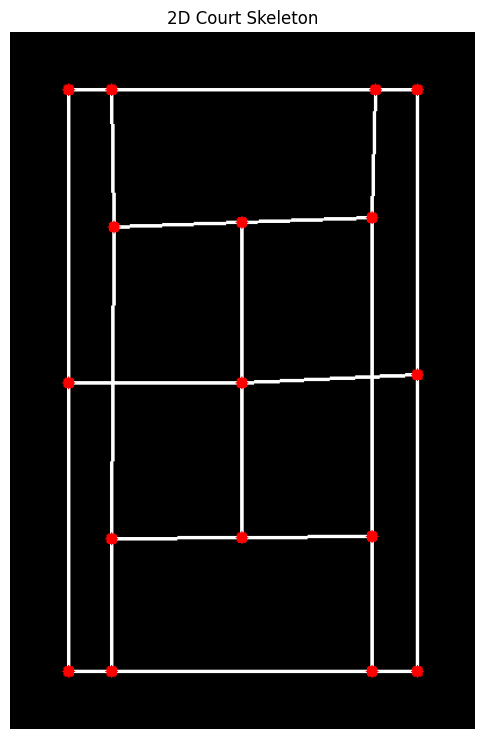


 Visualizing samples from tennis_game_train



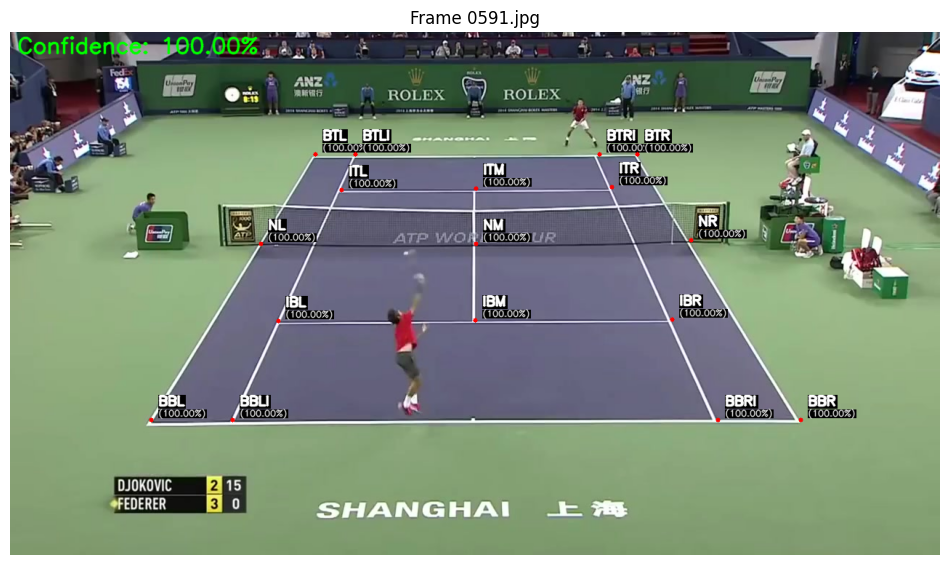

[07/18 01:17:34 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


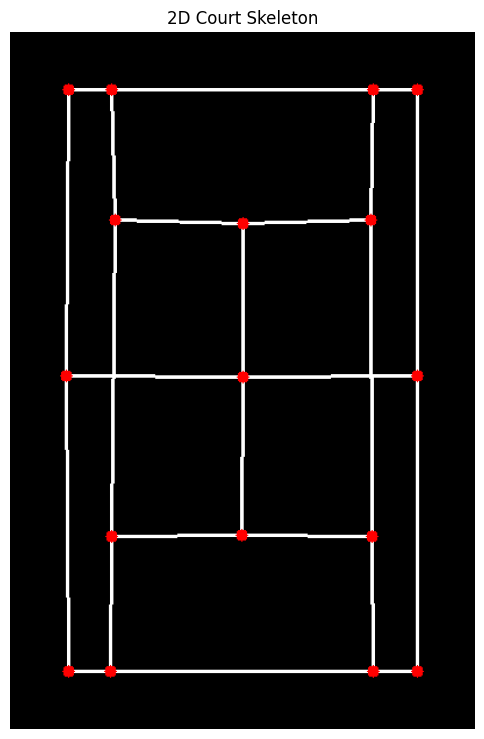


 Visualizing samples from tennis_game_train



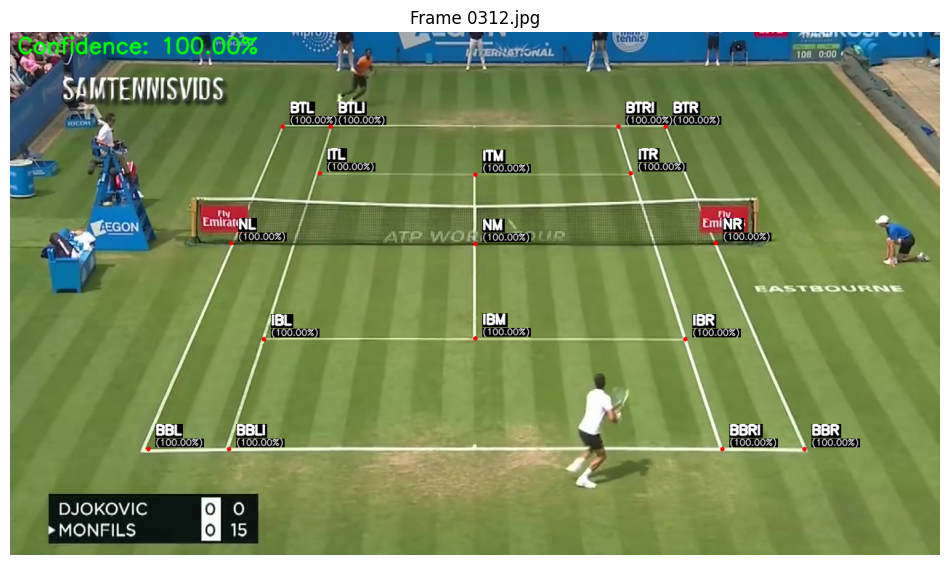

[07/18 01:17:37 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


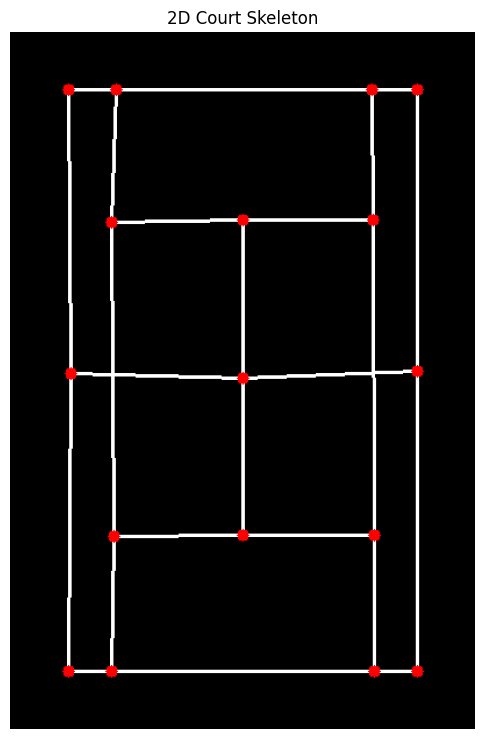


 Visualizing samples from tennis_game_train



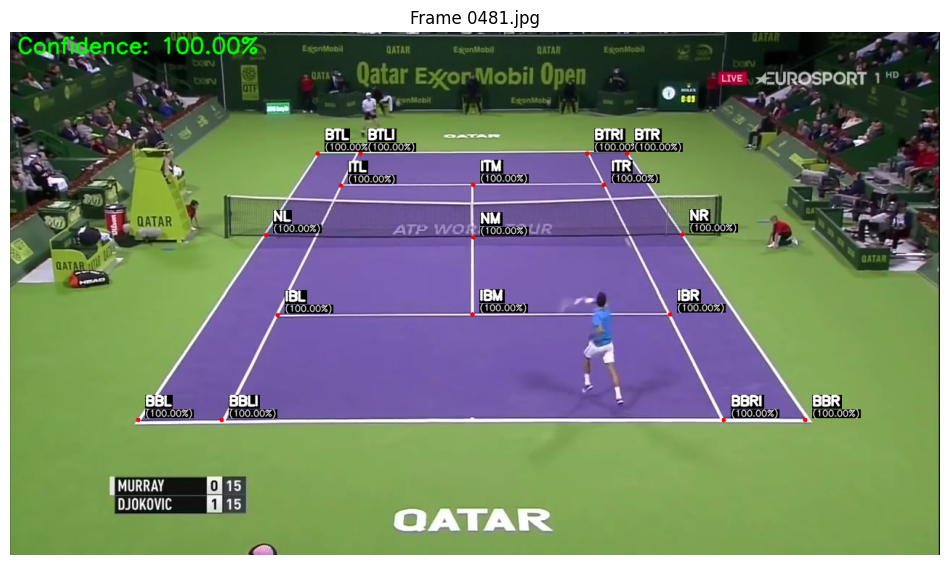

[07/18 01:17:39 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


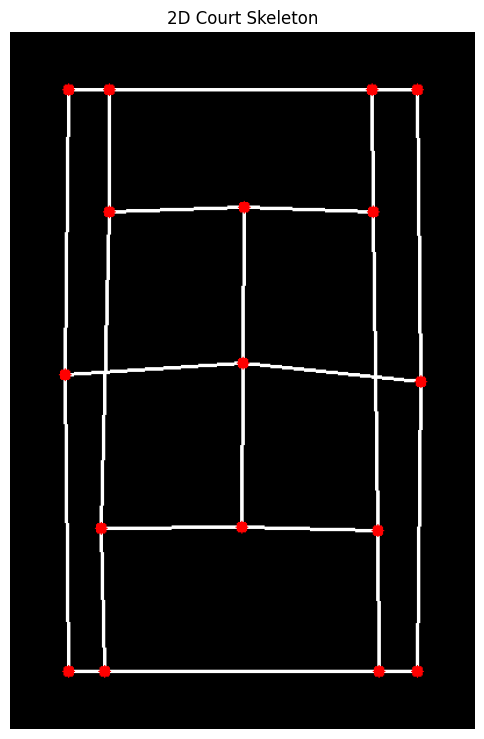


 Visualizing samples from tennis_game_train



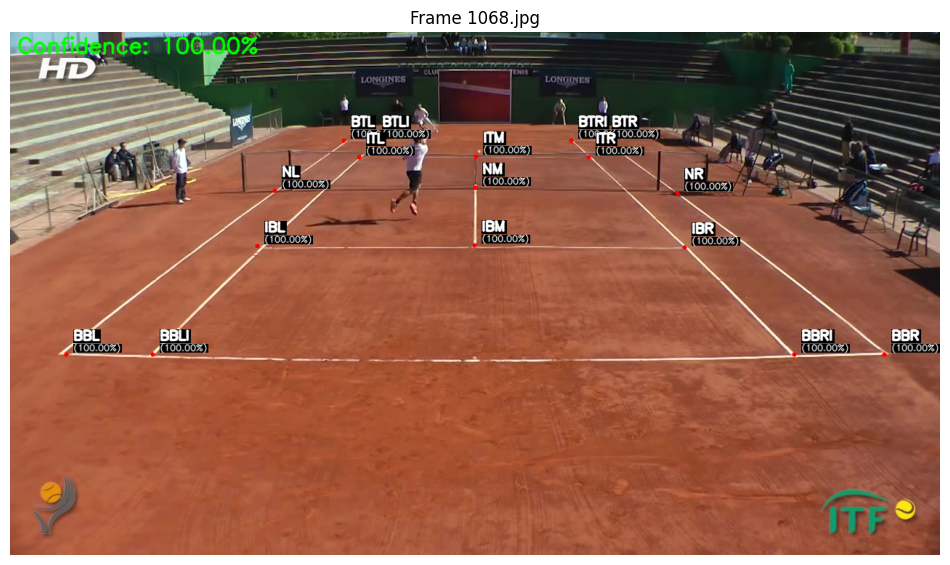

[07/18 01:17:41 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


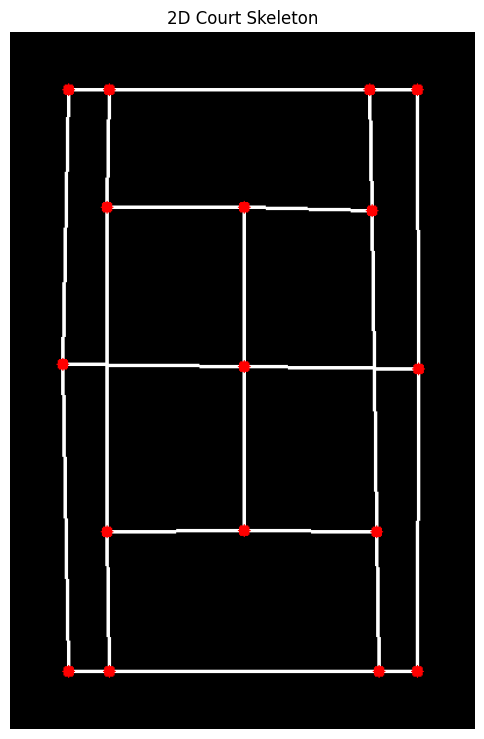


 Visualizing samples from tennis_game_train



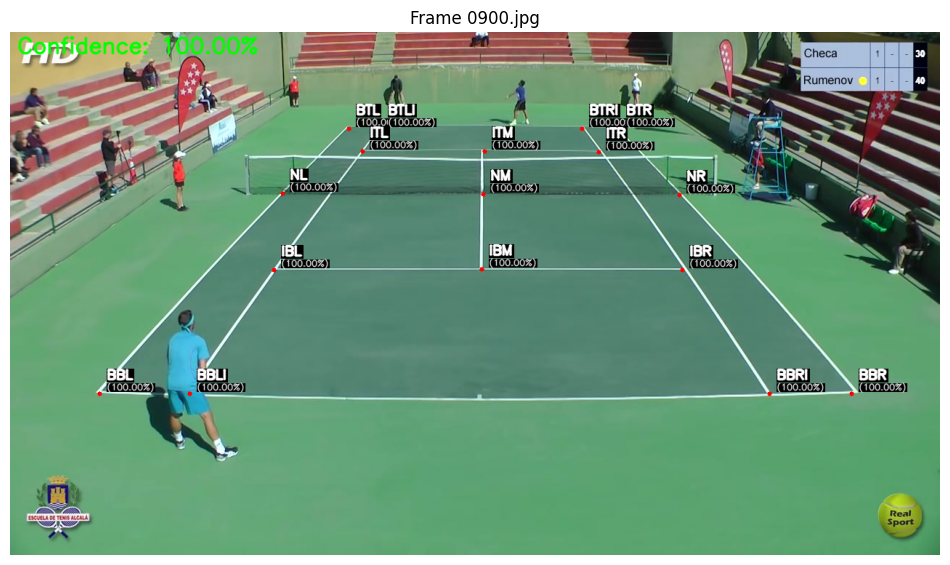

[07/18 01:17:44 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


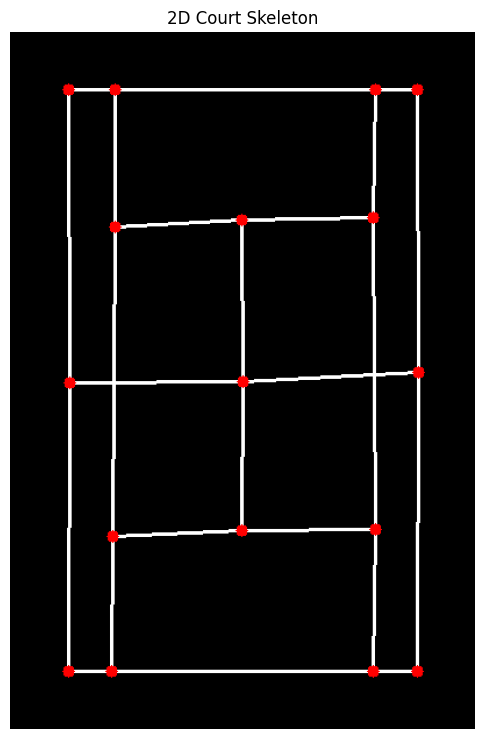


 Visualizing samples from tennis_game_train



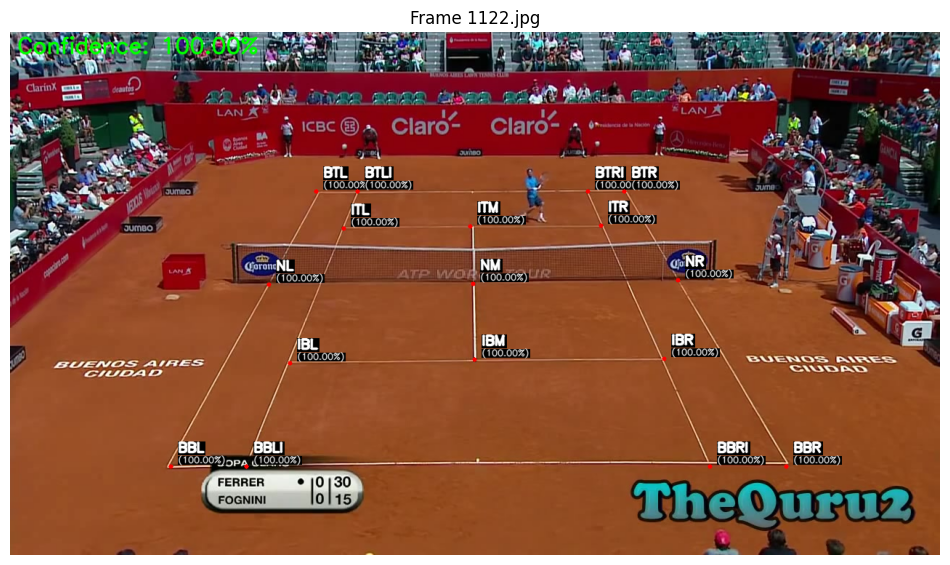

[07/18 01:17:46 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


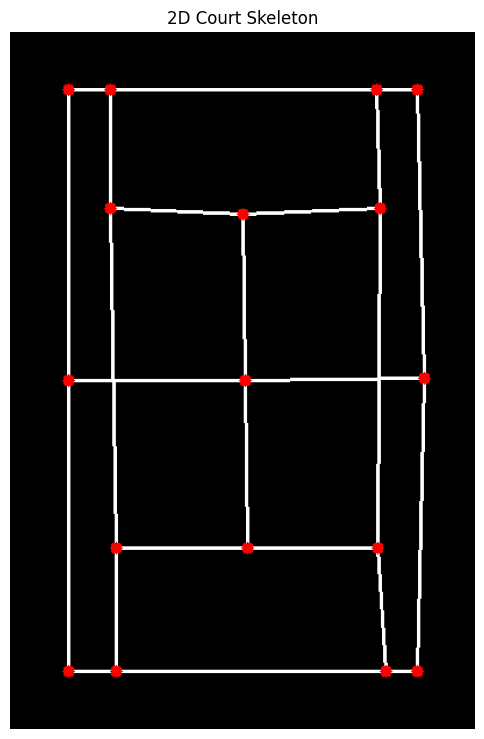


 Visualizing samples from tennis_game_train



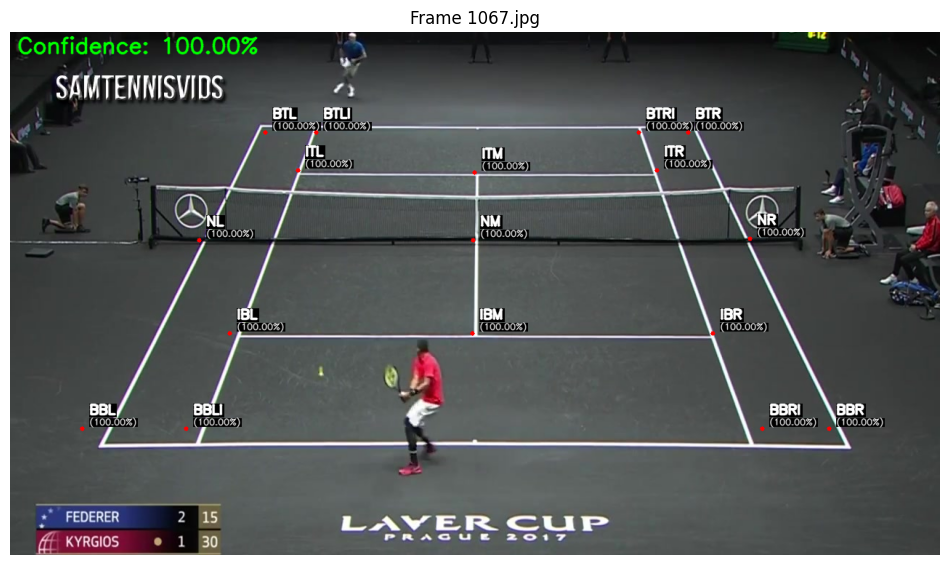

[07/18 01:17:48 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


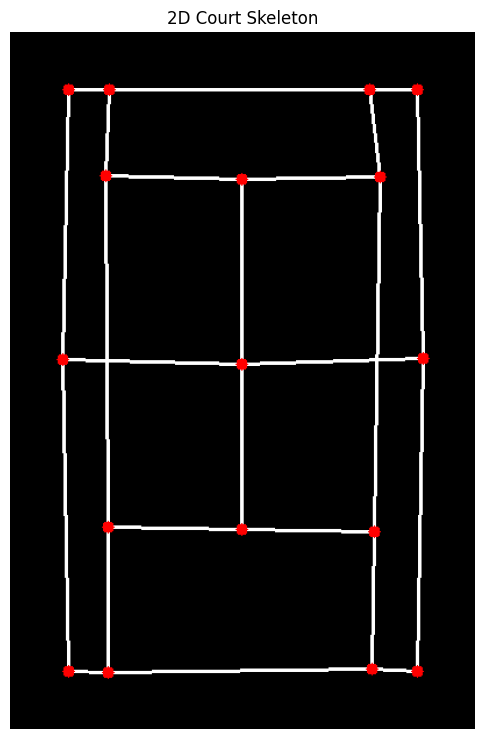


 Visualizing samples from tennis_game_train



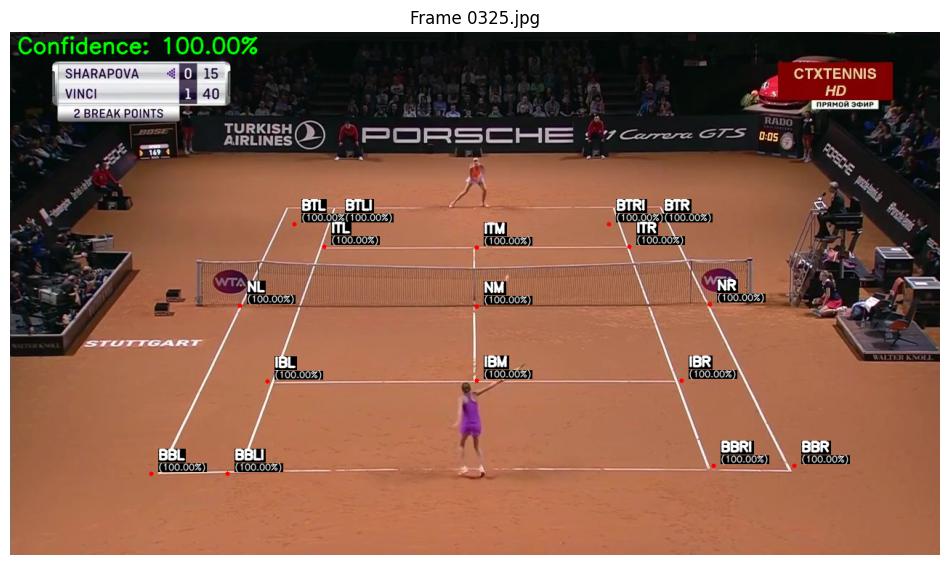

[07/18 01:17:50 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...


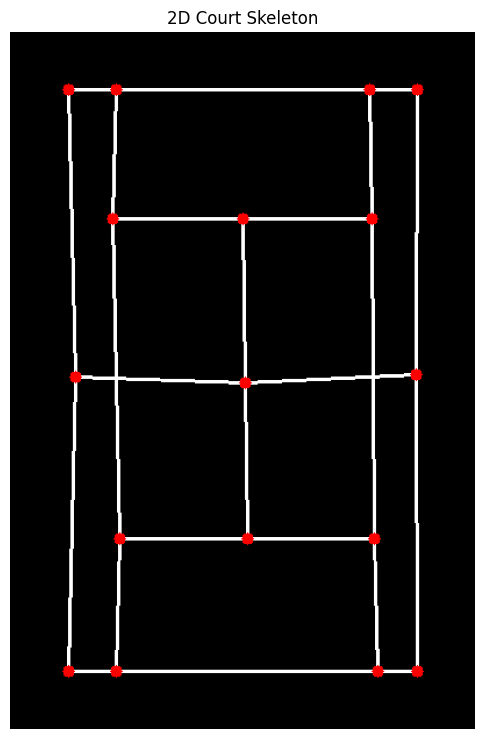


 Visualizing samples from tennis_game_train



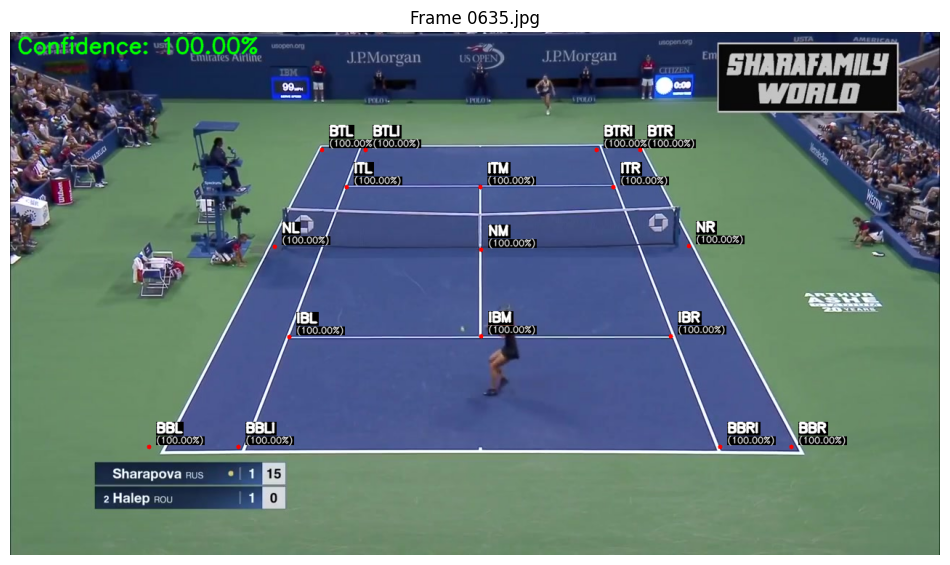

In [ ]:
# Function to transform keypoints to a fixed 2D plane
def transform_keypoints_to_2d(keypoints):
    keypoint_dict = {keypoint_names[i]: keypoints[i, :2] for i in range(len(keypoint_names))}
    src_points = np.array([
        keypoint_dict["BTL"],
        keypoint_dict["BTR"],
        keypoint_dict["BBL"],
        keypoint_dict["BBR"]
    ], dtype=np.float32)

    dst_points = np.array([
        [50, 50],
        [350, 50],
        [50, 550],
        [350, 550]
    ], dtype=np.float32)

    matrix = cv2.getPerspectiveTransform(src_points, dst_points)
    transformed_keypoints = cv2.perspectiveTransform(keypoints[None, :, :2], matrix)[0]

    return transformed_keypoints

# Function to visualize 2D court skeleton
def visualize_2d_court_skeleton(transformed_keypoints, lines):
    blank_image = np.zeros((600, 400, 3), np.uint8)

    # Draw lines between keypoints
    for start, end in lines:
        start_point = tuple(map(int, transformed_keypoints[keypoint_names.index(start)]))
        end_point = tuple(map(int, transformed_keypoints[keypoint_names.index(end)]))
        cv2.line(blank_image, start_point, end_point, (255, 255, 255), 2)

    # Draw keypoints
    for point in transformed_keypoints:
        point = tuple(map(int, point))
        cv2.circle(blank_image, point, 5, (0, 0, 255), -1)

    return blank_image

# Main function to process a few frames and create the 2D visualization
def main():
    for game_number in test_games:
        frames = []
        num_frames_to_process = num_frames  # Use the specified number of frames
        config_path, model_weights, dataset_name, dataset_path = get_paths(session_number, game_number)
        predictor = load_model(config_path, model_weights, dataset_name)

        image_files = sorted([f for f in os.listdir(dataset_path) if f.endswith('.jpg')])
        selected_files = random.sample(image_files, num_frames_to_process)

        for image_file in selected_files:
            img_path = os.path.join(dataset_path, image_file)
            img = cv2.imread(img_path)
            if img is not None:
                frames.append(img)

        for frame in frames:
            outputs = predictor(frame)
            instances = outputs["instances"].to("cpu")

            if len(instances) > 0:
                max_conf_idx = instances.scores.argmax()
                keypoints = instances.pred_keypoints.numpy()[max_conf_idx]
                transformed_keypoints = transform_keypoints_to_2d(keypoints)
                court_skeleton = visualize_2d_court_skeleton(transformed_keypoints, lines)

                # Display the 2D court skeleton
                plt.figure(figsize=(6, 10))
                plt.imshow(cv2.cvtColor(court_skeleton, cv2.COLOR_BGR2RGB))
                plt.axis('off')
                plt.title("2D Court Skeleton")
                plt.show()

                # Display the original frame with keypoints
                visualized_img = visualize_predictions_with_labels(frame, predictor, keypoint_names, dataset_name)
                plt.figure(figsize=(12, 8))
                plt.imshow(cv2.cvtColor(visualized_img, cv2.COLOR_BGR2RGB))
                plt.axis('off')
                plt.title(f"Frame {image_file}")
                plt.show()

# Run the main function
if __name__ == "__main__":
    main()

In [ ]:
import cv2
import numpy as np
import os
import random
from matplotlib import pyplot as plt

# Function to transform keypoints to a fixed 2D plane
def transform_keypoints_to_2d(keypoints):
    keypoint_dict = {keypoint_names[i]: keypoints[i, :2] for i in range(len(keypoint_names))}
    src_points = np.array([
        keypoint_dict["BTL"],
        keypoint_dict["BTR"],
        keypoint_dict["BBL"],
        keypoint_dict["BBR"]
    ], dtype=np.float32)

    dst_points = np.array([
        [50, 50],
        [350, 50],
        [50, 550],
        [350, 550]
    ], dtype=np.float32)

    matrix = cv2.getPerspectiveTransform(src_points, dst_points)
    transformed_keypoints = cv2.perspectiveTransform(keypoints[None, :, :2], matrix)[0]

    return transformed_keypoints

# Function to visualize 2D court skeleton
def visualize_2d_court_skeleton(transformed_keypoints):
    blank_image = np.zeros((600, 400, 3), np.uint8)

    # Draw lines between keypoints
    for start, end in lines:
        start_point = tuple(map(int, transformed_keypoints[keypoint_names.index(start)]))
        end_point = tuple(map(int, transformed_keypoints[keypoint_names.index(end)]))
        cv2.line(blank_image, start_point, end_point, (255, 255, 255), 2)

    # Draw keypoints
    for point in transformed_keypoints:
        point = tuple(map(int, point))
        cv2.circle(blank_image, point, 5, (0, 0, 255), -1)

    return blank_image

# Function to create a video from 2D visualized frames
def create_2d_video_from_frames(output_dir, dataset_path, predictor, video_name):
    os.makedirs(output_dir, exist_ok=True)
    video_path = os.path.join(output_dir, video_name)
    image_files = sorted([f for f in os.listdir(dataset_path) if f.endswith('.jpg')])

    if len(image_files) == 0:
        logger.error(f"No images found in {dataset_path}")
        return

    first_image_path = os.path.join(dataset_path, image_files[0])
    first_image = cv2.imread(first_image_path)
    height, width, layers = 600, 400, 3

    video = cv2.VideoWriter(video_path, cv2.VideoWriter_fourcc(*'mp4v'), 30, (width, height))

    for image_file in image_files:
        img_path = os.path.join(dataset_path, image_file)
        img = cv2.imread(img_path)
        if img is None:
            continue
        outputs = predictor(img)
        instances = outputs["instances"].to("cpu")

        if len(instances) > 0:
            max_conf_idx = instances.scores.argmax()
            keypoints = instances.pred_keypoints.numpy()[max_conf_idx]
            transformed_keypoints = transform_keypoints_to_2d(keypoints)
            court_skeleton = visualize_2d_court_skeleton(transformed_keypoints)
            video.write(court_skeleton)

    video.release()
    logger.info(f"Video saved to {video_path}")
    print(f"Video saved to {video_path}")  # Print the directory where the video is saved

# Main function to create 2D videos for each game
def main():
    for game_number in test_games:
        config_path, model_weights, dataset_name, dataset_path = get_paths(session_number, game_number)
        predictor = load_model(config_path, model_weights, dataset_name)
        output_dir = f"/content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/post_processing/session{session_number}/game{game_number}"
        video_name = f"2d_game{game_number}_session{session_number}.mp4"
        create_2d_video_from_frames(output_dir, dataset_path, predictor, video_name)

# Run the main function
if __name__ == "__main__":
    main()


[07/18 01:22:57 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...
Video saved to /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/post_processing/session9/game1/2d_game1_session9.mp4
[07/18 01:25:02 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...
Video saved to /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/post_processing/session9/game2/2d_game2_session9.mp4
[07/18 01:26:25 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/ASA Tennis Bounds Project/models/court_detection_model/detectron2/game_model/model_final.pth ...
Video saved to /content/drive/MyDrive/ASA Tennis Bounds 